**Project plan**

*Data preprocessing
1. DONE - Detect the english tweets
https://github.com/rfk/pyenchant

*Sentiment Analysis*
1. Find a sentiment analysis NN to rate last tweets
2. DONE - Extract the emoji's and incorporate the emoji sentiment <br>
https://stackoverflow.com/questions/43852668/using-collections-counter-to-count-emojis-with-different-colors<br>
https://stackoverflow.com/questions/48340622/extract-all-emojis-from-string-and-ignore-fitzpatrick-modifiers-skin-tones-etc

*Build a pipeline for similar tweet recommender*
1. DONE - Implement class for recommend engine
2. DONE - Build a pipeline for word embedding, vectorizing, and recommendation
3. Try out Glove, Google embedding.. etc

*Expansion
1. Narrow down recommendation to resolved tickets
2. Perform 3 types of clustering
3. Perform cluster summarization

In [1]:
import string
import emoji
import regex
import pickle
import re
import enchant
import math
import inflect
import gensim

import numpy as np
import pandas as pd
import vaderSentiment

import matplotlib.pyplot as plt

from itertools import compress
from tqdm import tqdm_notebook
from termcolor import colored


# gensim
from gensim import corpora, models, similarities, matutils
# sklearn
from sklearn import datasets
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.feature_extraction import text
from sklearn.decomposition import NMF, TruncatedSVD
import nltk.sentiment.vader
from sklearn.neighbors import NearestNeighbors
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from nltk.stem import WordNetLemmatizer
    
from sklearn.cluster import KMeans
from nltk.tokenize import word_tokenize

from sklearn.cluster import DBSCAN, SpectralClustering, MeanShift
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import MeanShift, estimate_bandwidth
from sklearn.cluster import KMeans
from itertools import cycle
import seaborn as sns

from sklearn import metrics
from sklearn.metrics import pairwise_distances
from sklearn.metrics import silhouette_score

%matplotlib inline

/Users/songlin/anaconda2/envs/Python36/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/Users/songlin/anaconda2/envs/Python36/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/Users/songlin/anaconda2/envs/Python36/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/Users/songlin/anaconda2/envs/Python36/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/Users/songlin/anaconda2/envs/Python36/lib/python3.6/site-packages/nltk/twitter/__init__.py:20: UserWarning: The twython library has not been installed. Some functionality 

In [2]:
twitter = pd.read_csv("./customer-support-on-twitter/twcs.csv")

# Save original message for future recommendation display
ticket_reserve = twitter[twitter['inbound'] == True]
solution_reserve = twitter[twitter['inbound'] == False]

In [3]:
twitter.shape

(2811774, 7)

In [3]:
pd.set_option('display.max_colwidth', -1)

### Exclude tweets with non-English characters

In [36]:
def fixContractions(text, cList):
    for word in text.split():
        if word.lower() in cList:
            text = text.replace(word, cList[word.lower()])
    return text

def clean_text(text, cList):
    text = text.lower()
    text = text.replace('\n', '')
    text = re.sub(r'https:\/\/t.co\/\w{10}', '', text) # Remove URL link
    text = re.sub(r'@\w+', '', text) # Remove @account
    text = re.sub(r'^\w+', '', text) # Remove @account
    text = fixContractions(text, cList) # Expand contractions
    return text

In [12]:
def get_emoji_free_text(text):
    text = text.replace(u'\u200d', '')
    allchars = [str for str in text]
    emoji_list = [c for c in allchars if c in emoji.UNICODE_EMOJI]
    clean_text = ' '.join([str for str in text.split() if not any(i in str for i in emoji_list)])
    if (len(emoji_list) == 0):
        return np.NaN, clean_text
    else:
        return emoji_list, clean_text

In [ ]:
with open('./data/helper/contraction_list.pkl', 'rb') as picklefile:
    cList = pickle.load(picklefile)
twitter['text'] = twitter['text'].apply(lambda x:clean_text(x, cList))
twitter[['emoji','text']] = twitter['text'].apply(lambda x:pd.Series(get_emoji_free_text(x)))

In [123]:
with open('./data/processed/tweets_step1_emoji_extracted.pkl', 'wb')as picklefile:
    pickle.dump(twitter, picklefile)

In [ ]:
with open('./data/processed/tweets_step1_emoji_extracted.pkl', 'rb')as picklefile:
    twitter = pickle.load(picklefile)

### Retrieve sentiment score for emoji's
ref:http://kt.ijs.si/data/Emoji_sentiment_ranking/

In [125]:
def build_dict(emoji_table, emoji_sentiment_dict):
    type_set = set()
    for i in range(emoji_table.shape[0]):
        code = emoji_table.loc[i, 'Python Code']
        try:
            key = chr(int(code[1:], 16))
            emoji_sentiment_dict[key] = emoji_table.loc[i, 'Sentiment score']
        except:
            type_set.add(emoji_table.loc[i, 'Unicode block'])
    return emoji_sentiment_dict

In [127]:
def get_emoji_sentiment(emoji_list):
    score = 0
    if (type(emoji_list) != float):
        for emoji_item in emoji_list:
            if (emoji_item in emoji_sentiment_dict.keys()):
                score += emoji_sentiment_dict[emoji_item]
        if (score == 0):
            return np.NaN
        else:
            return score/len(emoji_list)
    else:
        return np.NaN

In [169]:
emoji_sentiment = pd.read_csv('./data/raw/emoji_nodingbat.csv')
emoji_other = pd.read_csv('./data/raw/emoji_other.csv')
emoji_sentiment_dict = {}

emoji_sentiment_dict = build_dict(emoji_sentiment, emoji_sentiment_dict)
emoji_sentiment_dict = build_dict(emoji_other, emoji_sentiment_dict)

twitter['emoji_score'] = twitter['emoji'].apply(lambda x:get_emoji_sentiment(x))
print ('Number of tweets with emoji score: ', twitter[~twitter['emoji_score'].isnull()].shape[0])
print ('Number of tweets with emoji but not score: ', twitter[twitter['emoji_score'].isnull() & (~twitter['emoji'].isnull())].shape[0])

Number of tweets with emoji score:  161402
Number of tweets with emoji but not score:  33223


In [129]:
with open('./data/processed/tweets_step2_emoji_sentiment.pkl', 'wb')as picklefile:
    pickle.dump(twitter, picklefile)

In [167]:
with open('./data/processed/tweets_step2_emoji_sentiment.pkl', 'rb')as picklefile:
    twitter = pickle.load(picklefile)

### Remove non-English tweets

In [170]:
# Retrieve elements that are printable in English context - This is a 
# combination of digits, letters, punctuation, and whitespace.
valid_content = set(string.printable)

# Include some common non-English punctuations
non_English_punctuation = ['‘', '’', 'é', '–','—','“','”','、','。','`','️', '£', '…', '$']

# Keep tweets with common non-English punctuations
[valid_content.add(x) for x in (non_English_punctuation)]
    
def isEnglish(tweet):
    invalid_index = [x not in valid_content for x in tweet]
    if (np.sum(invalid_index)==0):
        return True
    else:
        return False

## Removed 78k tweets with non-English characters
english_tweets = twitter.text.apply(lambda x:isEnglish(x))
tweets = twitter.loc[english_tweets, :]

In [171]:
# A quick tool to return non-English words
def non_English(words):
    print (list(compress(list(words), [x not in valid_content for x in words])))

### Format the dates

In [173]:
# Format the dates
tweets['created_at'] = pd.to_datetime(tweets['created_at'], format='%a %b %d %H:%M:%S +0000 %Y')

/Users/songlin/anaconda2/envs/Python36/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [174]:
tweets['in_response_to_tweet_id'] = tweets['in_response_to_tweet_id'].fillna(-1)
tweets['in_response_to_tweet_id'] = tweets['in_response_to_tweet_id'].astype(int)
tweets['response_tweet_id'] = tweets['response_tweet_id'].fillna(-1)

/Users/songlin/anaconda2/envs/Python36/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.
/Users/songlin/anaconda2/envs/Python36/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
/Users/songlin/anaconda2/envs/Python36/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexe

In [175]:
with open('./data/processed/tweets_step3_english.pkl', 'wb')as picklefile:
    pickle.dump(tweets, picklefile)

In [8]:
with open('./data/processed/tweets_step3_english.pkl', 'rb')as picklefile:
    tweets = pickle.load(picklefile)

### Add custom_id and brand_id columns

In [198]:
# Add custom_id column
tweets = pd.merge(tweets,pd.DataFrame(tweets[['tweet_id', 'author_id']]),left_on='in_response_to_tweet_id', right_on='tweet_id', how='left')
tweets.loc[tweets['inbound'] == True, 'author_id_y'] = tweets.loc[tweets['inbound'] == True, 'author_id_x']
tweets['author_id_y'] = tweets['author_id_y'].fillna(-1)
tweets.drop('tweet_id_y', axis=1, inplace=True)
tweets.rename(columns={'author_id_y':'cust_id', 
                       'author_id_x':'author_id',
                      'tweet_id_x':'tweet_id'}, inplace=True)

# Drop the tweets without customer id, those are usually promotional tweets initiated by
# brands agent or customers not in the datase: Number of such tweets: 71255
tweets = tweets[~tweets['cust_id'].isnull()]

In [227]:
# Add brand_id column

# Carve out the first tweet id when there are multiples in response_tweet_id
tweets['processed_response_id'] = tweets['response_tweet_id'].apply(
    lambda x: x if (isinstance(x,int)) else x.split(',')[0])
tweets['processed_response_id'] = tweets['processed_response_id'].astype(int)

# Retrieve the author id of the responde tweet
tweets = pd.merge(tweets,pd.DataFrame(tweets[['tweet_id', 'author_id']]),
                  left_on='processed_response_id', 
                  right_on='tweet_id', 
                  how='left')

tweets.drop('tweet_id_y', axis=1, inplace=True)
tweets.rename(columns={'author_id_y':'brand_id', 
                       'author_id_x':'author_id',
                      'tweet_id_x':'tweet_id'}, inplace=True)

tweets = pd.merge(tweets,pd.DataFrame(tweets[['tweet_id', 'author_id']]),left_on='in_response_to_tweet_id', right_on='tweet_id', how='left')
tweets.loc[(tweets['inbound'] & (tweets['processed_response_id'] == -1)), 'brand_id'] = (
    tweets.loc[(tweets['inbound'] & (tweets['processed_response_id'] == -1)), 'author_id_y'])
tweets.rename(columns={'tweet_id_x':'tweet_id', 
                       'author_id_x':'author_id'}, inplace=True)

tweets.loc[tweets['inbound'] == False, 'brand_id'] = tweets.loc[tweets['inbound'] == False, 'author_id']
tweets.drop(['processed_response_id', 'tweet_id_y', 'author_id_y'], axis=1, inplace=True)

# could use some more logic to extract the account name in tweet text

In [233]:
# Tweets with no response is 3880
print (tweets[tweets['brand_id'].isnull() & (tweets['response_tweet_id'] == -1)].shape)

# Tweets with response outside the dataset is 42764
print (tweets[tweets['brand_id'].isnull() & (tweets['response_tweet_id'] != -1)].shape)

# Drop the tweets without brand_id
tweets = tweets[~tweets['brand_id'].isnull()]

In [6]:
# Identify which tweets are in the same conversation (customer case)
tweets.sort_values(['cust_id', 'created_at'], inplace=True)
tweets.reset_index(inplace=True)

# Calculate the time difference (in seconds) bwetween a tweet and its previous tweet
tweets['time_diff'] = tweets['created_at'].diff()
tweets['time_diff'] = tweets['time_diff'].apply(lambda x:x.total_seconds())
tweets['time_diff'] = tweets['time_diff'].apply(lambda x: 0 if x <0 else x)
tweets['time_diff'] = tweets['time_diff'].fillna(0)

tweets['case_id'] = 0
tweets['time_diff'] = tweets['time_diff'].fillna(0) 

In [ ]:
with open('./data/processed/tweets_step4_brand_cust.pkl', 'wb')as picklefile:
    pickle.dump(tweets, picklefile)

In [10]:
with open('./data/processed/tweets_step4_brand_cust.pkl', 'rb')as picklefile:
    tweets = pickle.load(picklefile)

In [13]:
brand = tweets[tweets['brand_id'] == 'SpotifyCares']

In [14]:
brand.shape

(86198, 11)

### Carve out the support data for a particular brand

In [7]:
def analyze_brand(tweets, brand_cc_name):
    ## Subset tweets according to brand
    brand = tweets[tweets['brand_id'] == brand_cc_name]
    brand.reset_index(inplace=True)
    
    ## Assign unique caseid for each conversation (interchange of tweets)
    ## To avoid grouping different cases raised by the same customer at different time
    ## We set the max threshold between subsequent tweets in a conversation as 2 days
    caseid = 1
    brand.loc[0, 'case_id'] = caseid
    for row in range(1, brand.shape[0]):
        if (row%1000 == 0):
            print (row)
        if ((brand.loc[row, 'cust_id'] != brand.loc[row-1, 'cust_id']) |
            (brand.loc[row, 'time_diff'] > 3600*24*2)):
            caseid = caseid + 1
            brand.loc[row, 'time_diff'] = 0 # Set time between conversations as 0
            brand.loc[row, 'case_id'] = caseid
        else:
            brand.loc[row, 'case_id'] = caseid
    return brand

In [8]:
# CAUTION! This function takes SUPER LONG TIME to run, 80k row takes 3 hours!
spotify = analyze_brand(tweets, 'SpotifyCares')

/Users/songlin/anaconda2/envs/Python36/lib/python3.6/site-packages/pandas/core/indexing.py:517: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


1000
2000
3000
4000
5000
6000
7000
8000
9000
10000
11000
12000
13000
14000
15000
16000
17000
18000
19000
20000
21000
22000
23000
24000
25000
26000
27000
28000
29000
30000
31000
32000
33000
34000
35000
36000
37000
38000
39000
40000
41000
42000
43000
44000
45000
46000
47000
48000
49000
50000
51000
52000
53000
54000
55000
56000
57000
58000
59000
60000
61000
62000
63000
64000
65000
66000
67000
68000
69000
70000
71000
72000
73000
74000
75000
76000
77000
78000
79000
80000
81000
82000
83000
84000
85000
86000


In [9]:
with open('./data/processed/spotify.pkl', 'wb')as picklefile:
    pickle.dump(spotify, picklefile)

In [3]:
with open('./data/processed/spotify.pkl', 'rb')as picklefile:
    spotify = pickle.load(picklefile)

### Remove ticket without solution and solution without ticket

In [4]:
conv_count = spotify.groupby('case_id')['case_id'].count()
single_conv_index = conv_count[conv_count==1].index.tolist()
spotify['single_conv'] = spotify['case_id'].apply(
    lambda x: True if x in single_conv_index else False)

# Remove the conversations with only one tweet (424 ) 
spotify = spotify[~spotify['single_conv']]
spotify.drop('single_conv', axis=1, inplace=True)

spotify.drop(['level_0', 'index'], axis=1, inplace=True)

In [5]:
ticket = spotify[spotify['inbound'] == True]
solution = spotify[spotify['inbound'] == False]

In [10]:
print (len(ticket.case_id.unique()))
len(solution.case_id.unique())

28796


28794

In [11]:
# Remove ticket without solution or solution without ticket 
# conversations with tweets from only customer or customer agents

ticket = ticket.apply(
    lambda x: x if (x[12] in solution['case_id'].unique()) else None, axis = 1)
solution = solution.apply(
    lambda x: x if (x[12] in ticket['case_id'].unique()) else None, axis = 1)

In [14]:
ticket[['tweet_id', 'text', 'case_id']]

,tweet_id,text,case_id
0,2747480.0,uh why is there a limit on how many songs i ca...,1.0
2,2747479.0,cool cool cool i think i am finally ready to s...,1.0
4,2606352.0,there used to be a useful feature in ios app t...,2.0
6,2606351.0,taking features away will only make it easier ...,2.0
8,855.0,i’m pissed my shuffle and repeat button just d...,3.0
10,853.0,iphone 7+ and i have the most recent update fo...,3.0
12,850.0,premium &amp; when i️ have it on shuffle it tu...,3.0
14,849.0,doesn’t work and i even tried deleting the app,3.0
16,862.0,groove music quits &amp; redirect to spotify. ...,4.0
18,861.0,version is 5.2.4.0. 7 of 10 app starts it says...,4.0


In [15]:
#ticket.text.fillna('', inplace=True)
#solution.text.fillna('', inplace=True)
ticket_agg = ticket.groupby('case_id')['text'].agg(lambda x:' '.join(x))
solution_agg = solution.groupby('case_id')['text'].agg(lambda x:' '.join(x))

In [ ]:
spotify = spotify.apply(
    lambda x: x if (x[10] in ticket['case_id'].unique()) else None, axis=1)

In [29]:
with open('./data/processed/ticket.pkl', 'wb')as picklefile:
    pickle.dump(ticket, picklefile)
with open('./data/processed/solution.pkl', 'wb')as picklefile:
    pickle.dump(solution, picklefile)
with open('./data/processed/ticket_agg.pkl', 'wb')as picklefile:
    pickle.dump(ticket_agg, picklefile)
with open('./data/processed/solution_agg.pkl', 'wb')as picklefile:
    pickle.dump(solution_agg, picklefile)

### Perform very basic sentiment analysis on last tweet from customer

In [54]:
cust_last_tweet = ticket.groupby('case_id')[['text','emoji', 'emoji_score']].last().reset_index()

In [55]:
vdanalyzer = vaderSentiment.vaderSentiment.SentimentIntensityAnalyzer()
cust_last_tweet['vader_sentiment'] = cust_last_tweet['text'].apply(
        lambda x:vdanalyzer.polarity_scores(x)['compound'])

In [56]:
sentiment_analyzer = nltk.sentiment.vader.SentimentIntensityAnalyzer()
cust_last_tweet['ntlk_sentiment'] = cust_last_tweet['text'].apply(
        lambda x:sentiment_analyzer.polarity_scores(x)['compound'])

In [58]:
cust_last_tweet.to_csv('./data/processed/processed_last_tweet_sentiment.csv', index=False)

In [60]:
cust_last_tweet = pd.read_csv('./data/processed/processed_last_tweet_sentiment.csv', index_col=None)

In [63]:
def get_overall_sentiment_score(row):
    sentiment = ''
    if (not math.isnan(row[3])):
        if (row[3] >= 0.2):
            sentiment = 'POS'
        elif ((row[3] < 0.2) & (row[3] > -0.05)):
            sentiment = 'NEU'
        elif (row[3] <= -0.05):
            sentiment = 'NEG'
    elif (not math.isnan(row[5])):
        if (row[5] >= 0.2):
            sentiment = 'POS'
        elif ((row[5] < 0.2) & (row[5] > -0.05)):
            sentiment = 'NEU'
        elif (row[5] <= -0.05):
            sentiment = 'NEG'
    return sentiment

In [64]:
cust_last_tweet[['emoji_score', 'ntlk_sentiment']] = cust_last_tweet[['emoji_score', 'ntlk_sentiment']].astype(float)
cust_last_tweet['sentiment'] = cust_last_tweet.apply(lambda
                        x:get_overall_sentiment_score(x), axis=1)

In [67]:
cust_last_tweet.to_csv('./data/processed/processed_last_tweet_sentiment.csv', index=False)

In [68]:
cust_last_tweet = pd.read_csv('./data/processed/processed_last_tweet_sentiment.csv', index_col=None)

In [70]:
spotify = pd.merge(spotify, cust_last_tweet[['case_id', 'sentiment']],
                   left_on='case_id', right_on='case_id',
                   how='left')

In [73]:
with open('./data/processed/tweets_step5_spotify_sentiment.pkl', 'wb')as picklefile:
    pickle.dump(spotify, picklefile)

In [15]:
with open('./data/processed/tweets_step5_spotify_sentiment.pkl', 'rb')as picklefile:
    spotify = pickle.load(picklefile)

In [20]:
cust_last_tweet[cust_last_tweet['sentiment']=='NEG'].shape[0]/cust_last_tweet.shape[0]

0.2584152568867892

### Tweets preprocessing

In [4]:
custom_stopwords = ['http', 'https', 'spotify', 'help', 'hi', 'spotifycares']
my_stop_words = (text.ENGLISH_STOP_WORDS.union(custom_stopwords)
                 .union(string.punctuation))

In [19]:
df_ticket = pd.DataFrame(ticket_agg)
df_ticket.reset_index(inplace=True)

In [172]:
ticket_agg.values

array(['uh why is there a limit on how many songs i can "save" — how am i supposed to keep track of the albums i like? cool cool cool i think i am finally ready to switch to apple music',
       'there used to be a useful feature in ios app that allowed user to hear sample of song by touch+hold on song. gone? taking features away will only make it easier for users to go. i’ve been a premium user for 4+ years... don’t let me leave.',
       'i’m pissed my shuffle and repeat button just don’t fucking work and i’m getting frustrated iphone 7+ and i have the most recent update for spotify premium &amp; when i️ have it on shuffle it turns off when the song is done and just plays in order and the repeat lights up but doesn’t repeat doesn’t work and i even tried deleting the app',
       ...,
       'i tried on many devices and browsers but does not work. really frustrated paying for a service she cannot use. help!',
       'here\'s the latest page, . if yr curious. to be clear: i do not have

In [171]:
df_ticket.text[0:5]

0    uh limit songs `` save '' — supposed track alb...
1    used useful feature ios app allowed user hear ...
2    ’ m pissed shuffle repeat button just don ’ t ...
3    groove music quits amp redirect w10m app bugfe...
4               way non-explicit songs explicit ok thx
Name: text, dtype: object

In [178]:
df_ticket.head()

,case_id,text,sentiment
0,1.0,uh limit songs `` save '' — supposed track alb...,POS
1,2.0,used useful feature ios app allowed user hear ...,POS
2,3.0,’ m pissed shuffle repeat button just don ’ t ...,NEU
3,4.0,groove music quits amp redirect w10m app bugfe...,NEG
4,5.0,way non-explicit songs explicit ok thx,POS


In [191]:
test=ticket_agg[3].split()
test

['i’m',
 'pissed',
 'my',
 'shuffle',
 'and',
 'repeat',
 'button',
 'just',
 'don’t',
 'fucking',
 'work',
 'and',
 'i’m',
 'getting',
 'frustrated',
 'iphone',
 '7+',
 'and',
 'i',
 'have',
 'the',
 'most',
 'recent',
 'update',
 'for',
 'spotify',
 'premium',
 '&amp;',
 'when',
 'i️',
 'have',
 'it',
 'on',
 'shuffle',
 'it',
 'turns',
 'off',
 'when',
 'the',
 'song',
 'is',
 'done',
 'and',
 'just',
 'plays',
 'in',
 'order',
 'and',
 'the',
 'repeat',
 'lights',
 'up',
 'but',
 'doesn’t',
 'repeat',
 'doesn’t',
 'work',
 'and',
 'i',
 'even',
 'tried',
 'deleting',
 'the',
 'app']

In [194]:
'i’m' in cList.keys()
i'm
i'm

False

In [195]:
cList.keys()

dict_keys(["ain't", "aren't", "can't", "can't've", "'cause", "could've", "couldn't", "couldn't've", "didn't", "doesn't", "don't", "hadn't", "hadn't've", "hasn't", "haven't", "he'd", "he'd've", "he'll", "he'll've", "he's", "how'd", "how'd'y", "how'll", "how's", "i'd", "i'd've", "i'll", "i'll've", "i'm", "i've", "isn't", "it'd", "it'd've", "it'll", "it'll've", "it's", "let's", "ma'am", "mayn't", "might've", "mightn't", "mightn't've", "must've", "mustn't", "mustn't've", "needn't", "needn't've", "o'clock", "oughtn't", "oughtn't've", "shan't", "sha'n't", "shan't've", "she'd", "she'd've", "she'll", "she'll've", "she's", "should've", "shouldn't", "shouldn't've", "so've", "so's", "that'd", "that'd've", "that's", "there'd", "there'd've", "there's", "they'd", "they'd've", "they'll", "they'll've", "they're", "they've", "to've", "wasn't", "we'd", "we'd've", "we'll", "we'll've", "we're", "we've", "weren't", "what'll", "what'll've", "what're", "what's", "what've", "when's", "when've", "where'd", "wh

In [187]:
def fixContractions(text, cList):
    for word in text.split():
        if word.lower() in cList:
            text = text.replace(word, cList[word.lower()])
    return text

case_id
1.0     uh why is there a limit on how many songs i ca...
2.0     there used to be a useful feature in ios app t...
3.0     i’m pissed my shuffle and repeat button just d...
4.0     groove music quits &amp; redirect to spotify. ...
5.0     is there a way to find non-explicit songs that...
6.0     hey, im in need of assistance. i recently appl...
7.0                                     i have a question
8.0     why are my devices not doing the cool thing wh...
9.0     why are nena's releases between 2002 and 2012 ...
10.0    in other news should probs upgrade from shitty...
Name: text, dtype: object

In [ ]:
cLi

In [196]:
cList = {"’cause": 'because',
 "ain’t": 'am not',
 "aren’t": 'are not',
 "can’t": 'cannot',
 "can’t’ve": 'cannot have',
 "could’ve": 'could have',
 "couldn’t": 'could not',
 "couldn’t’ve": 'could not have',
 "didn’t": 'did not',
 "doesn’t": 'does not',
 "don’t": 'do not',
 "hadn’t": 'had not',
 "hadn’t’ve": 'had not have',
 "hasn’t": 'has not',
 "haven’t": 'have not',
 "he’d": 'he would',
 "he’d’ve": 'he would have',
 "he’ll": 'he will',
 "he’ll’ve": 'he will have',
 "he’s": 'he is',
 "how’d": 'how did',
 "how’d’y": 'how do you',
 "how’ll": 'how will',
 "how’s": 'how is',
 "i’d": 'i would',
 "i’d’ve": 'i would have',
 "i’ll": 'i will',
 "i’llve": 'i will have',
 "i’m": 'i am',
 "i’ve": 'i have',
 "isn’t": 'is not',
 "it’d": 'it had',
 "it’d’ve": 'it would have',
 "it’ll": 'it will',
 "it’ll’ve": 'it will have',
 "it’s": 'it is',
 "let’s": 'let us',
 "ma’am": 'madam',
 "mayn’t": 'may not',
 "might’ve": 'might have',
 "mightn’t": 'might not',
 "mightn’t’ve": 'might not have',
 "must’ve": 'must have',
 "mustn’t": 'must not',
 "mustn’t’ve": 'must not have',
 "needn’t": 'need not',
 "needn’t’ve": 'need not have',
 "o’clock": 'of the clock',
 "oughtn’t": 'ought not',
 "oughtn’t’ve": 'ought not have',
 "sha’n’t": 'shall not',
 "shan’t": 'shall not',
 "shan’t’ve": 'shall not have',
 "she’d": 'she would',
 "she’d’ve": 'she would have',
 "she’ll": 'she will',
 "she’ll’ve": 'she will have',
 "she’s": 'she is',
 "should’ve": 'should have',
 "shouldn’t": 'should not',
 "shouldn’t’ve": 'should not have',
 "so’s": 'so is',
 "so’ve": 'so have',
 "that’d": 'that would',
 "that’d’ve": 'that would have',
 "that’s": 'that is',
 "there’d": 'there had',
 "there’d’ve": 'there would have',
 "there’s": 'there is',
 "they’d": 'they would',
 "they’d’ve": 'they would have',
 "they’ll": 'they will',
 "they’ll’ve": 'they will have',
 "they’re": 'they are',
 "they’ve": 'they have',
 "to’ve": 'to have',
 "wasn’t": 'was not',
 "we’d": 'we had',
 "we’d’ve": 'we would have',
 "we’ll": 'we will',
 "we’ll’ve": 'we will have',
 "we’re": 'we are',
 "we’ve": 'we have',
 "weren’t": 'were not',
 "what’ll": 'what will',
 "what’ll’ve": 'what will have',
 "what’re": 'what are',
 "what’s": 'what is',
 "what’ve": 'what have',
 "when’s": 'when is',
 "when’ve": 'when have',
 "where’d": 'where did',
 "where’s": 'where is',
 "where’ve": 'where have',
 "who’ll": 'who will',
 "who’ll’ve": 'who will have',
 "who’s": 'who is',
 "who’ve": 'who have',
 "why’s": 'why is',
 "why’ve": 'why have',
 "will’ve": 'will have',
 "won’t": 'will not',
 "won’t’ve": 'will not have',
 "would’ve": 'would have',
 "wouldn’t": 'would not',
 "wouldn’t’ve": 'would not have',
 "y’all": 'you all',
 "y’all’d": 'you all would',
 "y’all’d’ve": 'you all would have',
 "y’all’re": 'you all are',
 "y’all’ve": 'you all have',
 "y’alls": 'you alls',
 "you’d": 'you had',
 "you’d’ve": 'you would have',
 "you’ll": 'you you will',
 "you’ll’ve": 'you you will have',
 "you’re": 'you are',
 "you’ve": 'you have',
 "'cause": 'because',
 "ain't": 'am not',
 "aren't": 'are not',
 "can't": 'cannot',
 "can't've": 'cannot have',
 "could've": 'could have',
 "couldn't": 'could not',
 "couldn't've": 'could not have',
 "didn't": 'did not',
 "doesn't": 'does not',
 "don't": 'do not',
 "hadn't": 'had not',
 "hadn't've": 'had not have',
 "hasn't": 'has not',
 "haven't": 'have not',
 "he'd": 'he would',
 "he'd've": 'he would have',
 "he'll": 'he will',
 "he'll've": 'he will have',
 "he's": 'he is',
 "how'd": 'how did',
 "how'd'y": 'how do you',
 "how'll": 'how will',
 "how's": 'how is',
 "i'd": 'i would',
 "i'd've": 'i would have',
 "i'll": 'i will',
 "i'll've": 'i will have',
 "i'm": 'i am',
 "i've": 'i have',
 "isn't": 'is not',
 "it'd": 'it had',
 "it'd've": 'it would have',
 "it'll": 'it will',
 "it'll've": 'it will have',
 "it's": 'it is',
 "let's": 'let us',
 "ma'am": 'madam',
 "mayn't": 'may not',
 "might've": 'might have',
 "mightn't": 'might not',
 "mightn't've": 'might not have',
 "must've": 'must have',
 "mustn't": 'must not',
 "mustn't've": 'must not have',
 "needn't": 'need not',
 "needn't've": 'need not have',
 "o'clock": 'of the clock',
 "oughtn't": 'ought not',
 "oughtn't've": 'ought not have',
 "sha'n't": 'shall not',
 "shan't": 'shall not',
 "shan't've": 'shall not have',
 "she'd": 'she would',
 "she'd've": 'she would have',
 "she'll": 'she will',
 "she'll've": 'she will have',
 "she's": 'she is',
 "should've": 'should have',
 "shouldn't": 'should not',
 "shouldn't've": 'should not have',
 "so's": 'so is',
 "so've": 'so have',
 "that'd": 'that would',
 "that'd've": 'that would have',
 "that's": 'that is',
 "there'd": 'there had',
 "there'd've": 'there would have',
 "there's": 'there is',
 "they'd": 'they would',
 "they'd've": 'they would have',
 "they'll": 'they will',
 "they'll've": 'they will have',
 "they're": 'they are',
 "they've": 'they have',
 "to've": 'to have',
 "wasn't": 'was not',
 "we'd": 'we had',
 "we'd've": 'we would have',
 "we'll": 'we will',
 "we'll've": 'we will have',
 "we're": 'we are',
 "we've": 'we have',
 "weren't": 'were not',
 "what'll": 'what will',
 "what'll've": 'what will have',
 "what're": 'what are',
 "what's": 'what is',
 "what've": 'what have',
 "when's": 'when is',
 "when've": 'when have',
 "where'd": 'where did',
 "where's": 'where is',
 "where've": 'where have',
 "who'll": 'who will',
 "who'll've": 'who will have',
 "who's": 'who is',
 "who've": 'who have',
 "why's": 'why is',
 "why've": 'why have',
 "will've": 'will have',
 "won't": 'will not',
 "won't've": 'will not have',
 "would've": 'would have',
 "wouldn't": 'would not',
 "wouldn't've": 'would not have',
 "y'all": 'you all',
 "y'all'd": 'you all would',
 "y'all'd've": 'you all would have',
 "y'all're": 'you all are',
 "y'all've": 'you all have',
 "y'alls": 'you alls',
 "you'd": 'you had',
 "you'd've": 'you would have',
 "you'll": 'you you will',
 "you'll've": 'you you will have',
 "you're": 'you are',
 "you've": 'you have'}

In [188]:
fixContractions(ticket_agg[3],cList)

'i’m pissed my shuffle and repeat button just don’t fucking work and i’m getting frustrated iphone 7+ and i have the most recent update for spotify premium &amp; when i️ have it on shuffle it turns off when the song is done and just plays in order and the repeat lights up but doesn’t repeat doesn’t work and i even tried deleting the app'

In [173]:
pd.DataFrame({'agg':ticket_agg.values,'reduced':df_ticket.text})

,agg,reduced
0,uh why is there a limit on how many songs i ca...,uh limit songs `` save '' — supposed track alb...
1,there used to be a useful feature in ios app t...,used useful feature ios app allowed user hear ...
2,i’m pissed my shuffle and repeat button just d...,’ m pissed shuffle repeat button just don ’ t ...
3,groove music quits &amp; redirect to spotify. ...,groove music quits amp redirect w10m app bugfe...
4,is there a way to find non-explicit songs that...,way non-explicit songs explicit ok thx
5,"hey, im in need of assistance. i recently appl...",hey im need assistance recently applied studen...
6,i have a question,question
7,why are my devices not doing the cool thing wh...,devices doing cool thing play strangerthings a...
8,why are nena's releases between 2002 and 2012 ...,nena 's releases 2002 2012 missing 1982 2017 s...
9,in other news should probs upgrade from shitty...,news probs upgrade shitty 12gb package


In [20]:
df_solution = pd.DataFrame(solution_agg)
df_solution.reset_index(inplace=True)

In [22]:
cust_last_tweet = pd.read_csv('./data/processed/processed_last_tweet_sentiment.csv', index_col=None)

In [23]:
df_ticket = pd.merge(df_ticket, cust_last_tweet[['case_id', 'sentiment']], left_on='case_id', right_on='case_id',
                   how='left')

In [24]:
def text_preprocess(text):
    tokens = word_tokenize(text)
    lemmatize = WordNetLemmatizer()
    clean_text = [lemmatize.lemmatize(token.lower().strip(), pos='a') for token in tokens]
    clean_text = [x for x in clean_text if x not in my_stop_words]
    return ' '.join(clean_text)

In [25]:
df_ticket['text'] = df_ticket.text.apply(lambda x:text_preprocess(x))

In [26]:
with open('./data/processed/tweets_step6_ticket_preprocessed.pkl', 'wb')as picklefile:
    pickle.dump(df_ticket, picklefile)

### Build recommendation engines

In [4]:
## Read in files from previous steps
with open('./data/processed/tweets_step6_ticket_preprocessed.pkl', 'rb')as picklefile:
    df_ticket = pickle.load(picklefile)

cust_last_tweet = pd.read_csv('./data/processed/processed_last_tweet_sentiment.csv', index_col=None)

with open('./data/processed/ticket.pkl', 'rb')as picklefile:
    ticket = pickle.load(picklefile)

with open('./data/processed/solution.pkl', 'rb')as picklefile:
    solution = pickle.load(picklefile)
    
with open('./data/processed/ticket_agg.pkl', 'rb')as picklefile:
    ticket_agg = pickle.load(picklefile)

with open('./data/processed/solution_agg.pkl', 'rb')as picklefile:
    solution_agg = pickle.load(picklefile)
'''
with open('./data/processed/engines.pkl', 'rb') as picklefile:
    engines = pickle.load(picklefile)

engine_1 = engines[1]
engine_2 = engines[2]
engine_3 = engines[3]
'''    

"\nwith open('./data/processed/engines.pkl', 'rb') as picklefile:\n    engines = pickle.load(picklefile)\n\nengine_1 = engines[1]\nengine_2 = engines[2]\nengine_3 = engines[3]\n"

In [5]:
custom_stopwords = ['http', 'https', 'spotify', 'help', 'hi', 'spotifycares']
my_stop_words = (text.ENGLISH_STOP_WORDS.union(custom_stopwords)
                 .union(string.punctuation))

In [7]:
with open('./data/processed/engines.pkl', 'rb') as picklefile:
    engines = pickle.load(picklefile)

engine_1 = engines[1]
engine_2 = engines[2]
engine_3 = engines[3]

AttributeError: Can't get attribute 'RecommendationEngine' on <module '__main__'>

In [90]:
class RecommendationEngine:
    def __init__(self, vectorizer, n_components, reducer, ticket, solution):
        self.vectorizer = vectorizer
        self.n_dim = n_components
        self.reducer = reducer(n_components)
        self.ticket = ticket
        self.solution = solution
        
    def fit(self, df):
        self.vector_data = self.vectorizer.fit_transform(df['text'])
        self.topic_data = self.reducer.fit_transform(self.vector_data)
        self.df = df_ticket
        return self.topic_data
    
    def _print_recommendations(self, article, rec_list):
        p = inflect.engine()
        print('NEW MESSAGE:', article)
        i = 1
        for resp in self.df.loc[rec_list]['case_id']:
            print(f'\n---{p.ordinal(i)} SIMILAR CONVERSATION---\n')
            self._display_conversation(resp)
            print('\n')
            i += 1
    
    def _display_conversation (self, case_id):
        cust_conv = self.ticket[self.ticket['case_id'] == case_id][['created_at', 'inbound', 'text']]
        agent_conv = self.solution[self.solution['case_id'] == case_id][['created_at', 'inbound', 'text']]
        conv_list = pd.concat([cust_conv, agent_conv]).sort_values('created_at')
        for i in range(conv_list.shape[0]):
            if (conv_list.iloc[i]['inbound']):
                print ('CUSTOMER:   ', colored(conv_list.iloc[i]['text'], 'red'))
            else:
                print ('AGENT:      ', colored(conv_list.iloc[i]['text'], 'green'))
        
    def recommend(self, article, num_to_return):
        article_vectorized = self.vectorizer.transform([article])
        article_topic_vector = self.reducer.transform(article_vectorized)
        nn = NearestNeighbors(n_neighbors=num_to_return, metric='cosine', algorithm='brute')
        
        tmp = self.vectorizer.transform(self.df[self.df['sentiment']=='POS'].text)
        tmp2 = self.reducer.transform(tmp)
        
        nn.fit(tmp2)
        results = nn.kneighbors(article_topic_vector)
        #result_texts = [self.texts[i] for i in results[1][0]]
        rec_list = results[1][0]
        print ('number of results: ', len(rec_list))
        self._print_recommendations(article, rec_list)
        
        return rec_list
    
    def display_topics(self, no_top_words, topic_names=None):
        feature_names = self.vectorizer.get_feature_names()
        for ix, topic in enumerate(self.reducer.components_):
            if not topic_names or not topic_names[ix]:
                print("\nTopic ", ix)
            else:
                print("\nTopic: '",topic_names[ix],"'")
            print(", ".join([feature_names[i]
                for i in topic.argsort()[:-no_top_words - 1:-1]]))

In [49]:
ticket_origin = pd.merge(ticket_reserve[['tweet_id', 'created_at', 'inbound', 'text']], ticket[['tweet_id', 'case_id']], left_on='tweet_id', right_on='tweet_id', how='right')
solution_origin = pd.merge(solution_reserve[['tweet_id', 'created_at', 'inbound', 'text']], solution[['tweet_id', 'case_id']], left_on='tweet_id', right_on='tweet_id', how='right')

In [13]:
tfidf_vectorizer = TfidfVectorizer(ngram_range=(1, 2),  
                                   stop_words=my_stop_words, 
                                   token_pattern="\\b[a-z][a-z]+\\b",
                                   lowercase=True,
                                   max_df = 0.4)

count_vectorizer = CountVectorizer(ngram_range=(1, 2),  
                                   stop_words='english', 
                                   token_pattern="\\b[a-z][a-z]+\\b",
                                   lowercase=True,
                                   max_df = 0.4)


#tfidf_data = tfidf_vectorizer.fit_transform(list(df_ticket.text))

In [34]:
tfidf_data = tfidf_vectorizer.fit_transform(list(df_ticket.text))
lsa_tfidf = TruncatedSVD(n_components=50)
lsa_tfidf_data = lsa_tfidf.fit_transform(tfidf_data)
cv_data = count_vectorizer.fit_transform(list(df_ticket.text))
cv_nmf = NMF(n_components=10)
cv_nmf_data = cv_nmf.fit_transform(cv_data)

NameError: name 'tfidf_vectorizer' is not defined

In [270]:
engine_1 = RecommendationEngine(tfidf_vectorizer, n_components = 100, reducer = TruncatedSVD, ticket = ticket_origin, solution=solution_origin)
topic_data = engine_1.fit(df_ticket)

In [ ]:
engine_2 = RecommendationEngine(count_vectorizer, n_components = 100, reducer = NMF, ticket = ticket_origin, solution=solution_origin)
engine_2.fit(df_ticket)

array([[1.45299026e-02, 0.00000000e+00, 0.00000000e+00, ...,
        1.58887629e-01, 1.41779320e-03, 1.65902187e-01],
       [0.00000000e+00, 0.00000000e+00, 1.15349244e-01, ...,
        0.00000000e+00, 6.38668481e-03, 0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 1.12784504e-01, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       ...,
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 2.64000460e-03, 0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 2.32531208e-01, ...,
        0.00000000e+00, 3.78228393e-03, 6.12230398e-05],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00]])

In [ ]:
engine_3 = RecommendationEngine(tfidf_vectorizer, n_components = 100, reducer = NMF, ticket = ticket_origin, solution=solution_origin)
engine_3.fit(df_ticket)

In [225]:
engine_dict = {1:engine_1, 2:engine_2, 3:engine_3}

In [226]:
with open('./data/processed/engines.pkl', 'wb') as picklefile:
    pickle.dump(engine_dict, picklefile)

In [210]:
cust_first_tweet = ticket.groupby('case_id')[['text']].first().reset_index()
sample = cust_first_tweet.text[np.random.choice(cust_first_tweet.shape[0])]

In [265]:
index = 30

In [266]:
engine_1.recommend(cust_first_tweet.text[index], 3)

number of results:  3
NEW MESSAGE: is there anyway to move songs around so they are in my order and not the order of when i added them...if that makes sense?

---1st SIMILAR CONVERSATION---

CUSTOMER:    @SpotifyCares I'm getting a "400 Illegal character 0x1B" error from https://t.co/ShdHDc7dpU according to chrome, something on my end?
AGENT:       @302582 Hi David! Can you send us a DM with your username or email address? We'll take a look under the hood /HR https://t.co/ldFdZRiNAt



---2nd SIMILAR CONVERSATION---

CUSTOMER:    um i just went to put together a little xtina playlist for my shower only to find back to basics isn’t on spotify anymore??? @SpotifyCares https://t.co/Qae75mDL94
AGENT:       @175986 Hey there! We’d love to have all of their stuff available, but we have some info about content here: https://t.co/MEjmIRL2eB /RV



---3rd SIMILAR CONVERSATION---

CUSTOMER:    @SpotifyCares how does the mobile payment works?
AGENT:       @434244 Hey there! Could you send us your

array([ 7191,  2213, 11966])

In [267]:
engine_2.recommend(cust_first_tweet.text[index], 3)

number of results:  3
NEW MESSAGE: is there anyway to move songs around so they are in my order and not the order of when i added them...if that makes sense?

---1st SIMILAR CONVERSATION---

CUSTOMER:    Touch Preview topic is still #1 on the hot list of the @115888 forums, still hasn’t been added back. I still hate companies. @SpotifyCares https://t.co/UKBCSzjocT
AGENT:       @164940 Hey! We have more info about this here: https://t.co/pXBCq8GlsI. Give us a shout if you have any questions /AR
CUSTOMER:    @SpotifyCares You’ve responded with this same bogus reply a million times. Don’t respond unless you’re actually going to listen to your customers
AGENT:       @164940 We're sorry if you feel that way. We're taking in your comments, and we'll be sure to pass them on to the right team /AR
CUSTOMER:    @SpotifyCares Same bogus reply again 🙄 hi @115948



---2nd SIMILAR CONVERSATION---

CUSTOMER:    @SpotifyCares I'm getting a "400 Illegal character 0x1B" error from https://t.co/ShdHDc7d

array([1930, 7191, 9260])

In [268]:
engine_3.recommend(cust_first_tweet.text[index], 3)

number of results:  3
NEW MESSAGE: is there anyway to move songs around so they are in my order and not the order of when i added them...if that makes sense?

---1st SIMILAR CONVERSATION---

CUSTOMER:    @SpotifyCares i bought premium and its not showing up on my account but the funds have cleared my account
AGENT:       @329781 Hey Amy! Can you DM us your account's email address and username? We'll take a look backstage /SU https://t.co/ldFdZRiNAt



---2nd SIMILAR CONVERSATION---

CUSTOMER:    @SpotifyCares I am attempting to purchase premium. However, everytime I try it says that there is an issue with my bank despite using a (fully activated) mastercard. They have worked all of the other times I have used them. Please help.
AGENT:       @281688 Hey, help's here! Could you send us a DM with your account's email address? We'll take a look backstage /CH https://t.co/ldFdZRiNAt



---3rd SIMILAR CONVERSATION---

CUSTOMER:    @SpotifyCares I need to switch my account to a student accoun

array([8223, 6429,  512])

In [269]:
recommend_word2vec(df_ticket, google_model, 3, cust_first_tweet.text[index])

/Users/songlin/anaconda2/envs/Python36/lib/python3.6/site-packages/ipykernel_launcher.py:7: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).
  import sys
/Users/songlin/anaconda2/envs/Python36/lib/python3.6/site-packages/ipykernel_launcher.py:15: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).
  from ipykernel import kernelapp as app


NEW MESSAGE: is there anyway to move songs around so they are in my order and not the order of when i added them...if that makes sense?

---1st SIMILAR CONVERSATION---

CUSTOMER:    why is my web player in malay? where are the language settings
AGENT:       hi there. can you dm us your account's email address? we will take a look backstage /lm



---2nd SIMILAR CONVERSATION---

CUSTOMER:    is there a way to block artists? like if i do not support their music or their message i can prevent them from even showing?
AGENT:       hey! this is not possible right now, but you can show your support for the idea in our community: /cp



---3rd SIMILAR CONVERSATION---

CUSTOMER:    please help me i have two months paid but no premium service!!!
AGENT:       hey there, help's here! can you dm us your account's email address? we will take a look under the hood /mv




### Try word2vec model

In [15]:
# Function to take a document as a list of words and return the document vector
def get_doc_vec(words, model):
    good_words = []
    for word in words:
        # Words not in the original model will fail
        try:
            if model.wv[word] is not None:
                good_words.append(word)
        except:
            continue
    # If no words are in the original model
    if len(good_words) == 0:
        return [0.0]*300
    # Return the mean of the vectors for all the good words
    return model.wv[good_words].mean(axis=0)

In [16]:
google_vec_file = '~/Downloads/GoogleNews-vectors-negative300.bin'
google_model = gensim.models.KeyedVectors.load_word2vec_format(google_vec_file, binary=True)

In [17]:
def print_recommendations(df, article, rec_list):
    p = inflect.engine()
    print('NEW MESSAGE:', article)
    i = 1
    for resp in df.loc[rec_list]['case_id']:
        print(f'\n---{p.ordinal(i)} SIMILAR CONVERSATION---\n')
        display_conversation(resp)
        print('\n')
        i += 1

def display_conversation (case_id):
    cust_conv = ticket[ticket['case_id'] == case_id][['created_at', 'inbound', 'text']]
    agent_conv = solution[solution['case_id'] == case_id][['created_at', 'inbound', 'text']]
    conv_list = pd.concat([cust_conv, agent_conv]).sort_values('created_at')
    for i in range(conv_list.shape[0]):
        if (conv_list.iloc[i]['inbound']):
            print ('CUSTOMER:   ', colored(conv_list.iloc[i]['text'], 'red'))
        else:
            print ('AGENT:      ', colored(conv_list.iloc[i]['text'], 'green'))

In [18]:
def recommend_word2vec(df, model, num_to_return, article):
    tmp = df[df['sentiment']=='POS'].text
    ticket_google_vecs = tmp.map(lambda x: get_doc_vec(x.split(), model))
    df_ticket_google = pd.DataFrame(ticket_google_vecs.values.tolist())
    nn = NearestNeighbors(n_neighbors=num_to_return, metric='cosine', algorithm='brute')
    nn.fit(df_ticket_google)
    new_vecs = get_doc_vec(article.split(), model)
    tmp2 = pd.DataFrame([new_vecs.tolist()])
    rec_list = nn.kneighbors(tmp2)[1][0].tolist()
    
    print_recommendations(df, article, rec_list)
    return 

In [92]:
recommend_word2vec(df_ticket, google_model, 3, cust_first_tweet.text[index])

/Users/songlin/anaconda2/envs/Python36/lib/python3.6/site-packages/ipykernel_launcher.py:7: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).
  import sys
/Users/songlin/anaconda2/envs/Python36/lib/python3.6/site-packages/ipykernel_launcher.py:15: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).
  from ipykernel import kernelapp as app


NEW MESSAGE: why are my devices not doing the cool thing when i play the #strangerthings albums on ?

---1st SIMILAR CONVERSATION---

CUSTOMER:    any plans to improve queue functionality? (queuing on web player, clearing queue on android)
AGENT:       hey there! we do not have any info on this right now, but we will let the right team know it is something you had like to see /mx



---2nd SIMILAR CONVERSATION---

CUSTOMER:    anyone else's just randomly stop and close on #android. it is daily on my #galaxys8. so annoying. , can you shed light?
AGENT:       hey dan, help's here! could you dm us your device, operating system, and spotify version? we will take a look /q



---3rd SIMILAR CONVERSATION---

CUSTOMER:    i just paid for premium service via your webpage with facebook login yet my account is still showing only free service.
AGENT:       hey marcy, we are here to help! could you dm us your account's email address? we will take a look backstage /bx




In [22]:
ticket_google_vecs = df_ticket.text.map(lambda x: get_doc_vec(x.split(), google_model))
df_ticket_google = pd.DataFrame(ticket_google_vecs.values.tolist())

/Users/songlin/anaconda2/envs/Python36/lib/python3.6/site-packages/ipykernel_launcher.py:7: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).
  import sys
/Users/songlin/anaconda2/envs/Python36/lib/python3.6/site-packages/ipykernel_launcher.py:15: DeprecationWarning: Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).
  from ipykernel import kernelapp as app


In [23]:
df_ticket_google.shape

(28787, 300)

### Perform Clustering

### DBSCAN

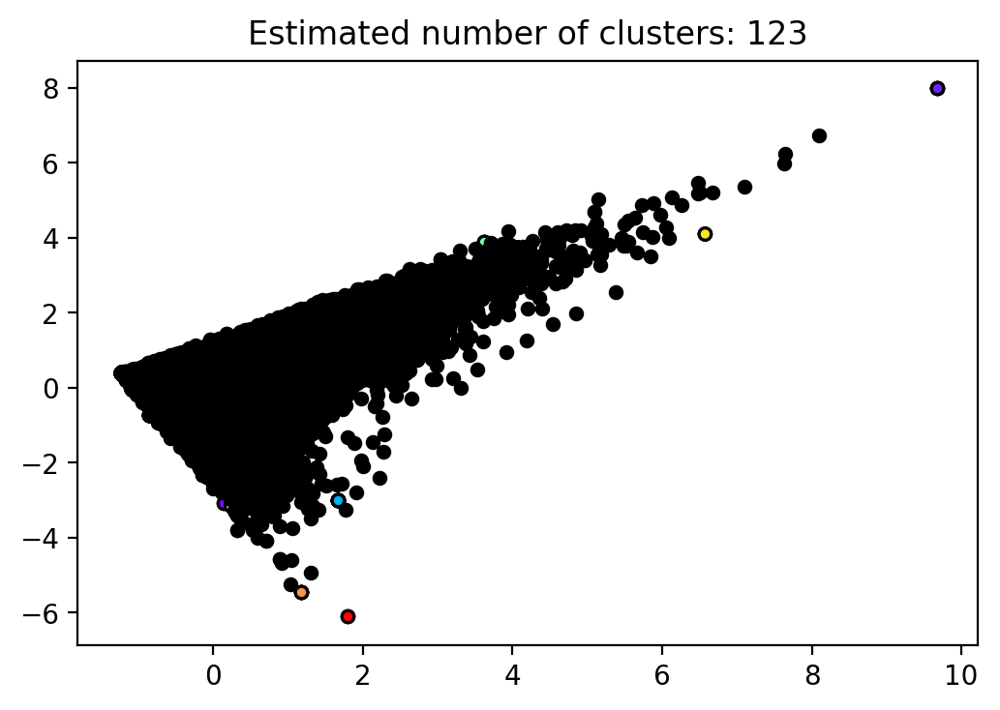

In [44]:
X = StandardScaler().fit_transform(lsa_tfidf_data)
db = DBSCAN(eps=0.15, min_samples=3).fit(X)

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

unique_labels = set(labels)
colors = plt.cm.rainbow(np.linspace(0, 1, len(unique_labels)))
plt.figure(dpi=200)
show_core = True
show_non_core = True
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = 'k'

    class_member_mask = (labels == k)
    if show_core:
        xy = X[class_member_mask & core_samples_mask]
        x, y = xy[:,0], xy[:,1]
        plt.scatter(x, y, c=col, edgecolors='k',  s=20, linewidths=1.1)
    
    if show_non_core:
        xy = X[class_member_mask & ~core_samples_mask]
        x, y = xy[:,0], xy[:,1]
        plt.scatter(x, y, c=col, s=20, linewidths=1.1)

plt.title('Estimated number of clusters: %d' % n_clusters_);

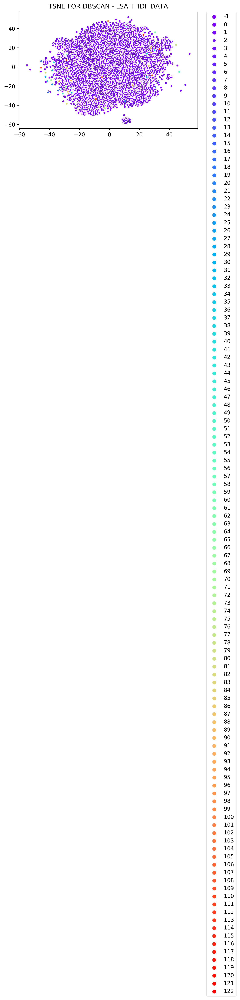

In [45]:
plt.figure(dpi=250)
plt.title("TSNE FOR DBSCAN - LSA TFIDF DATA")
sns.scatterplot(google_embedded[:, 0], google_embedded[:, 1], labels,
               size = 2, palette = 'rainbow', alpha = 'auto',
              markers = '.', legend="full");

plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);

### Mean Shift

In [46]:
# The following bandwidth can be automatically detected using
bandwidth = estimate_bandwidth(lsa_tfidf_data, quantile=0.2, n_samples=500)

ms = MeanShift(bandwidth=bandwidth, bin_seeding=True)
ms.fit(X)
labels = ms.labels_
cluster_centers = ms.cluster_centers_

labels_unique = np.unique(labels)
n_clusters_ = len(labels_unique)

print("number of estimated clusters : %d" % n_clusters_)

number of estimated clusters : 1


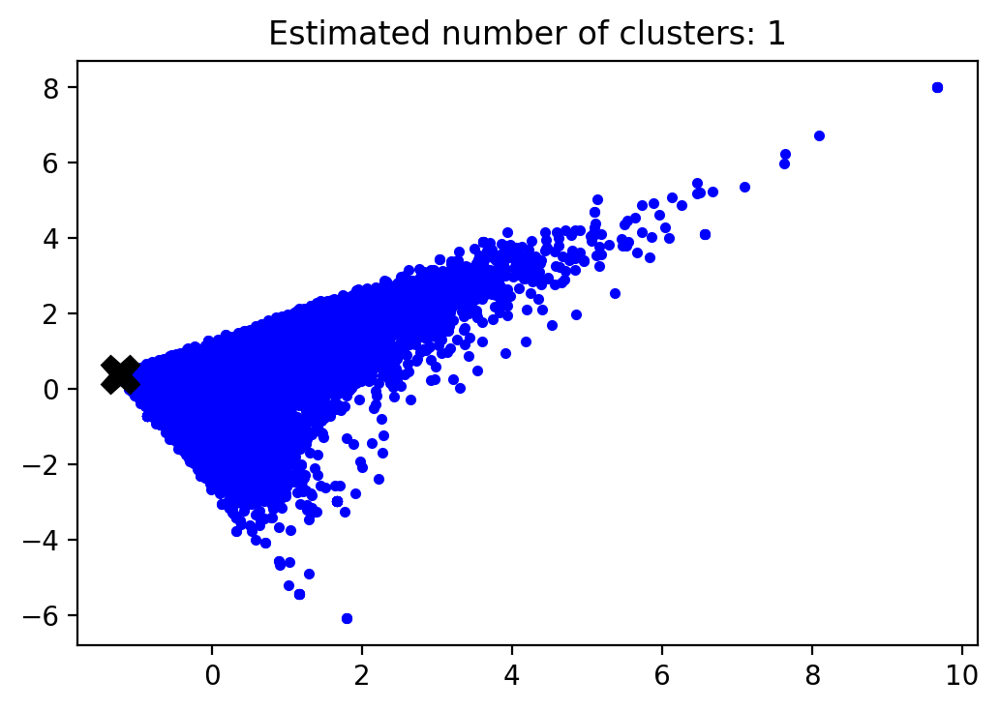

In [47]:
plt.figure(1)
plt.clf()
plt.figure(dpi=200)
colors = cycle('byrcmykbgrcmykbgrcmykbgrcmyk')
for k, col in zip(range(n_clusters_), colors):
    my_members = labels == k
    cluster_center = cluster_centers[k]
    plt.plot(X[my_members, 0], X[my_members, 1], col + '.')
    plt.plot(cluster_center[0], cluster_center[1], 'X', markerfacecolor='k',
             markeredgecolor='k', markersize=14)
plt.title('Estimated number of clusters: %d' % n_clusters_);

### KMeans

In [26]:
def get_cluster_centers(X, labels, k_num):
    CC_list = []
    for k in range(k_num):
        # get the mean coordinates of each cluster
        CC_list.append(np.mean(X[labels == k], axis = 0))
    return CC_list

# for each cluster substract the mean from each data point to get the error
# then get the magnitude of each error, square it, and sum it
def get_SSE(X, labels):
    k_num = len(np.unique(labels))
    CC_list = get_cluster_centers(X, labels, k_num)
    CSEs = []
    for k in range(k_num):
        # for each cluster of k we get the coordinates of how far off each point is to the cluster
        error_cords = X[labels == k] - CC_list[k]
        # square the coordinates and sum to get the magnitude squared
        error_cords_sq = error_cords ** 2
        error_mag_sq = np.sum(error_cords_sq, axis = 1)
        # since we already have the magnitude of the error squared we can just take the sum for the cluster
        CSE = np.sum(error_mag_sq)
        CSEs.append(CSE)
    # sum each cluster's sum of squared errors
    return sum(CSEs)

In [25]:
def find_elbow(data, low, high, step, title):
    SSEs = []
    X = StandardScaler().fit_transform(lsa_tfidf_data)
    for k in range(low, high, step):
        #print ('clustering trial:', k)
        km = KMeans(n_clusters=k, random_state=1)
        km.fit(X)
        labels = km.labels_
        #Sil_coefs.append(metrics.silhouette_score(lsa_tfidf_data, labels, metric='euclidean'))
        SSEs.append(get_SSE(X, labels)) # The SSE is just inertia, we could have just said km.inertia_

    k_clusters = range(low, high, step)
    plt.figure(dpi=200)

    # plot Intertia/SSE on ax2
    plt.plot(k_clusters, SSEs)
    plt.xlabel('number of clusters')
    plt.ylabel('SSE')
    plt.xticks(np.arange(low, high, step=step));
    plt.title ('SSE vs Clusters - ', title)
    return None

clustering trial: 2
clustering trial: 6
clustering trial: 10
clustering trial: 14
clustering trial: 18
clustering trial: 22
clustering trial: 26
clustering trial: 30
clustering trial: 34
clustering trial: 38
clustering trial: 42
clustering trial: 46
clustering trial: 50
clustering trial: 54
clustering trial: 58
clustering trial: 62
clustering trial: 66
clustering trial: 70
clustering trial: 74
clustering trial: 78
clustering trial: 82
clustering trial: 86
clustering trial: 90
clustering trial: 94
clustering trial: 98


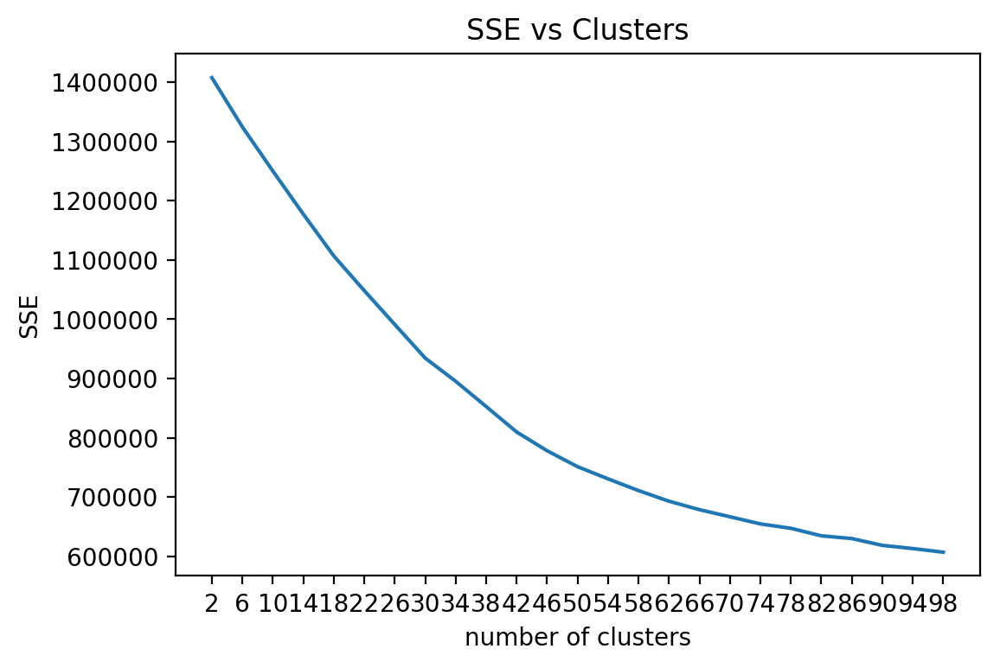

In [53]:
find_elbow(cv_nmf_data, 2, 100, 4)

In [52]:
def fitKmeans(data, n_clusters):
    X = StandardScaler().fit_transform(data)
    km = KMeans(n_clusters=n_clusters)
    y_pred = km.fit_predict(X)
    plt.figure(dpi=200)
    plt.scatter(X[:,0],X[:,1],c=plt.cm.rainbow(y_pred*20),s=14);
    return y_pred, km

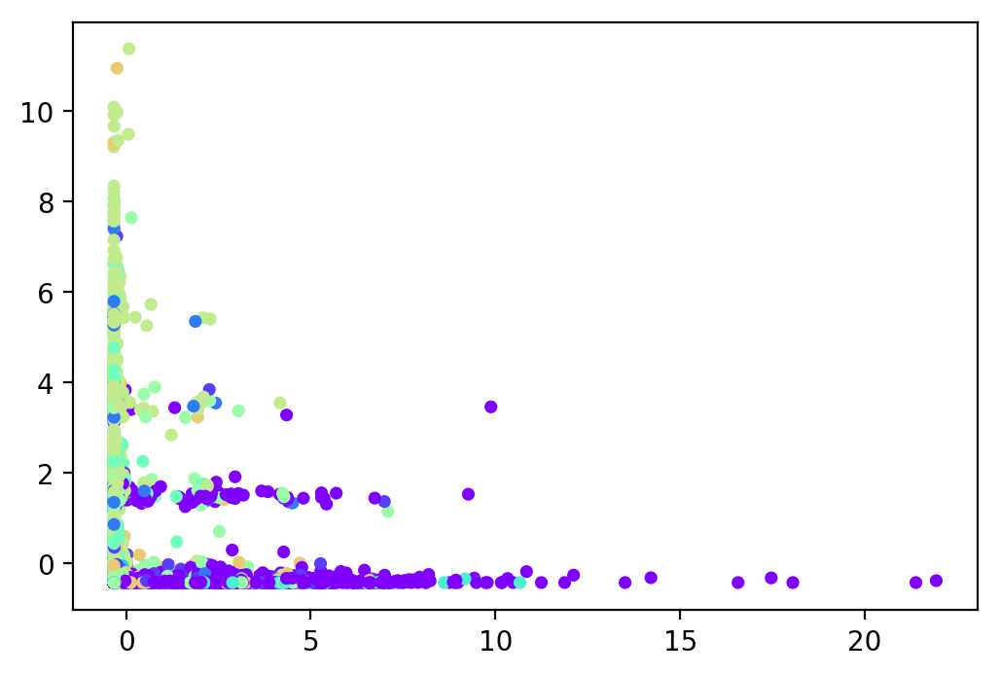

In [176]:
y_pred_cv_nmf = fitKmeans(cv_nmf_data, 15)

In [180]:
cv_nmf_embedded = TSNE(n_components=2, verbose=1, perplexity=50).fit_transform(cv_nmf_data)
cv_nmf_data.shape

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 28787 samples in 0.184s...
[t-SNE] Computed neighbors for 28787 samples in 9.277s...
[t-SNE] Computed conditional probabilities for sample 1000 / 28787
[t-SNE] Computed conditional probabilities for sample 2000 / 28787
[t-SNE] Computed conditional probabilities for sample 3000 / 28787
[t-SNE] Computed conditional probabilities for sample 4000 / 28787
[t-SNE] Computed conditional probabilities for sample 5000 / 28787
[t-SNE] Computed conditional probabilities for sample 6000 / 28787
[t-SNE] Computed conditional probabilities for sample 7000 / 28787
[t-SNE] Computed conditional probabilities for sample 8000 / 28787
[t-SNE] Computed conditional probabilities for sample 9000 / 28787
[t-SNE] Computed conditional probabilities for sample 10000 / 28787
[t-SNE] Computed conditional probabilities for sample 11000 / 28787
[t-SNE] Computed conditional probabilities for sample 12000 / 28787
[t-SNE] Computed conditional probabilities for sa

(28787, 10)

In [23]:
def plot_on_tsne(pred, title, tsne_embedded):
    plt.figure(dpi=250)
    plt.title(title)
    sns.scatterplot(tsne_embedded[:, 0], tsne_embedded[:, 1], pred,
                   size = 2, palette = 'rainbow', alpha = 'auto',
                  markers = '.', legend="full");

    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
    return None

In [179]:
cv_nmf_embedded.shape

(2000, 2)

ValueError: arrays must all be same length

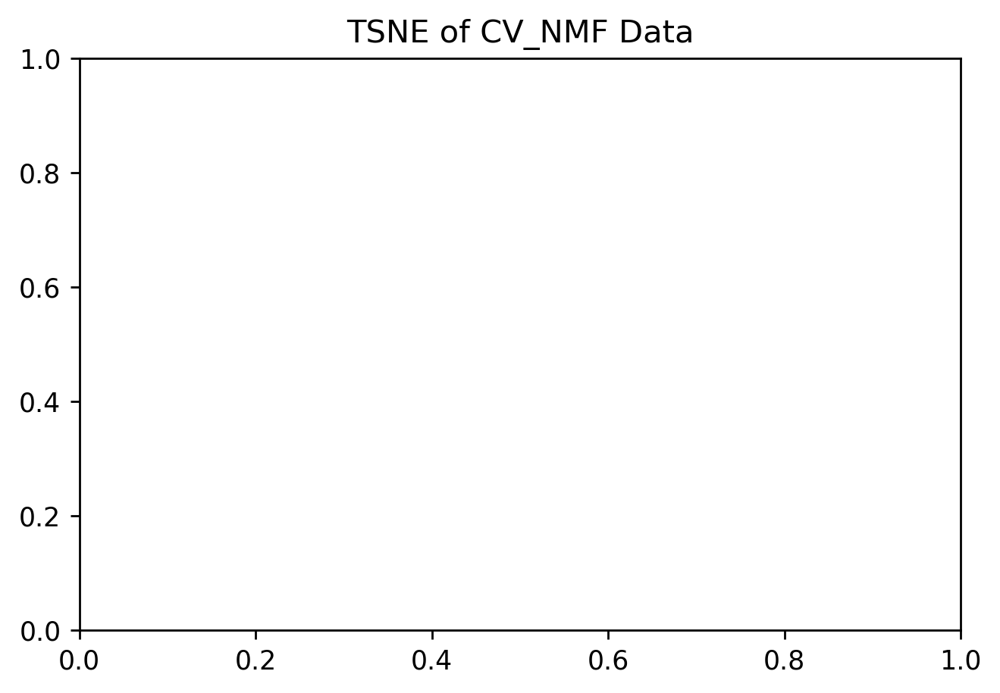

In [177]:
plot_on_tsne(y_pred_cv_nmf, 'TSNE of CV_NMF Data', cv_nmf_embedded)

In [88]:
def checkfeature_on_tsne(tsne_embedded, title, data, i):
    plt.figure(dpi=250)
    plt.title(f'{title} on topic {i}')
    sns.scatterplot(tsne_embedded[:, 0], tsne_embedded[:, 1], data[:,i],
                   size = 1, palette = 'cubehelix', alpha=0.4,
                  markers = '.', legend="brief");

    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);

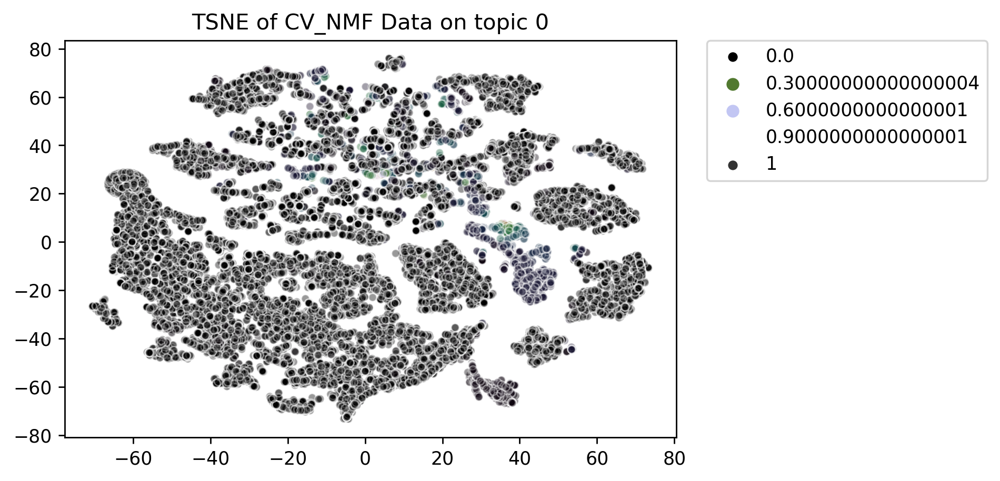

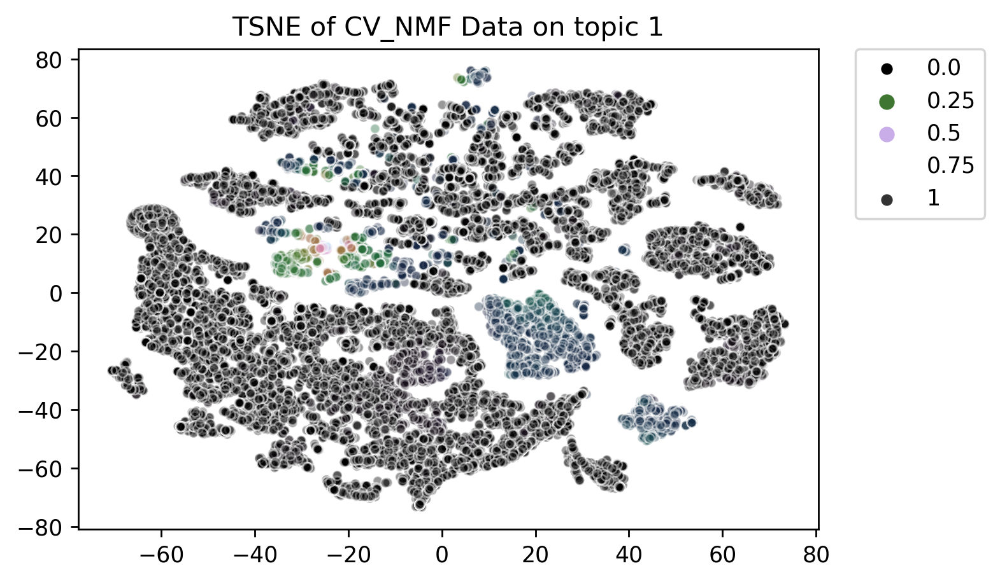

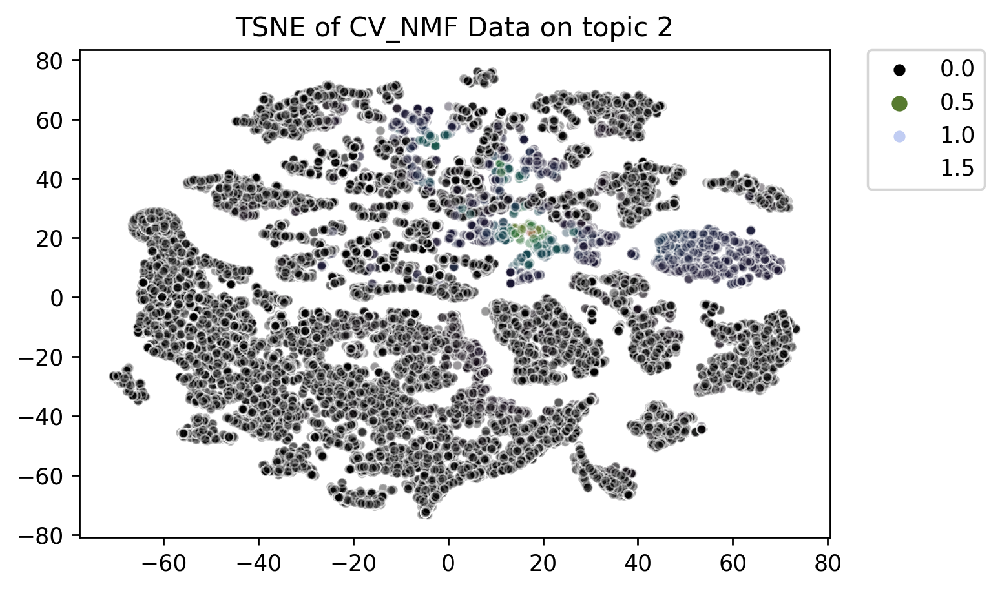

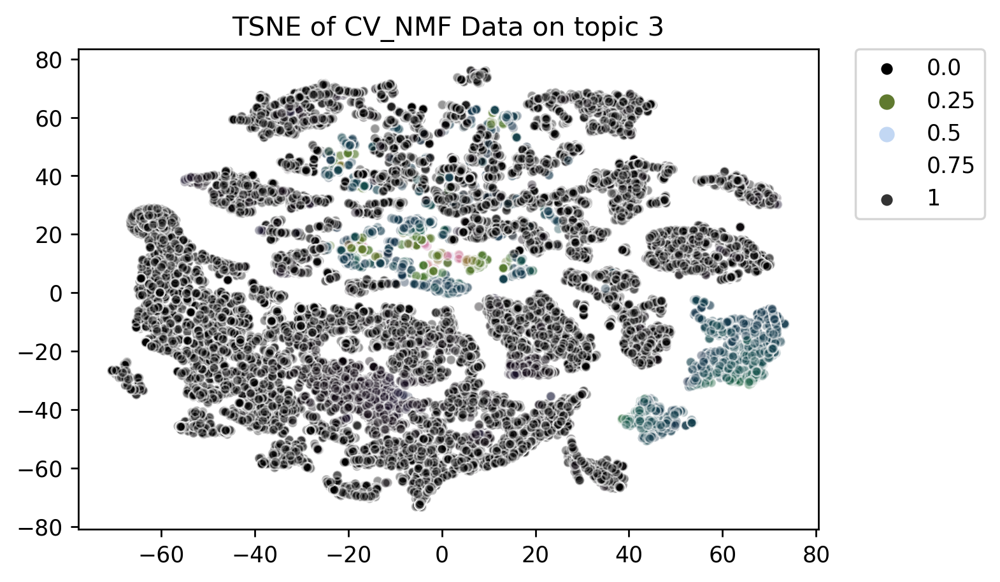

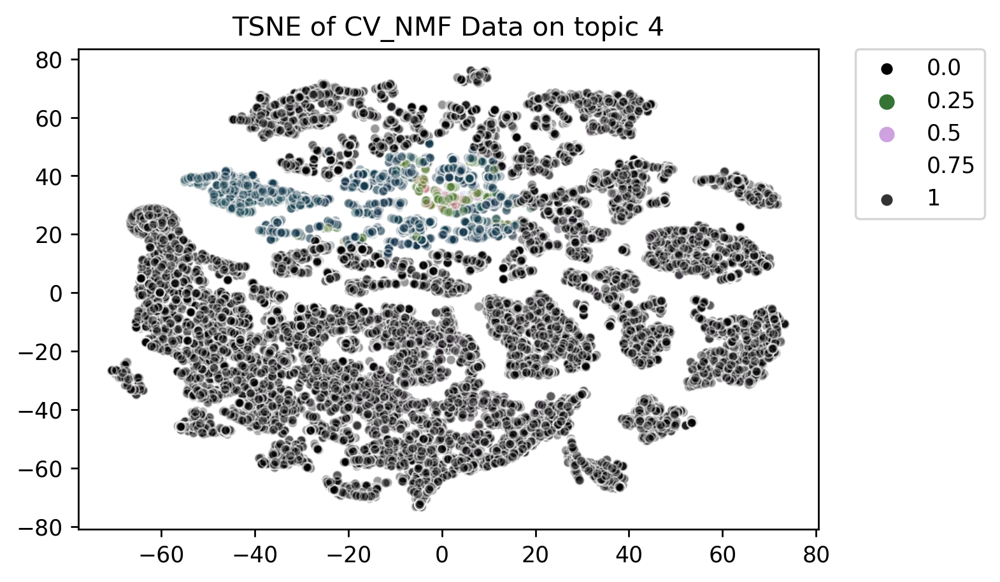

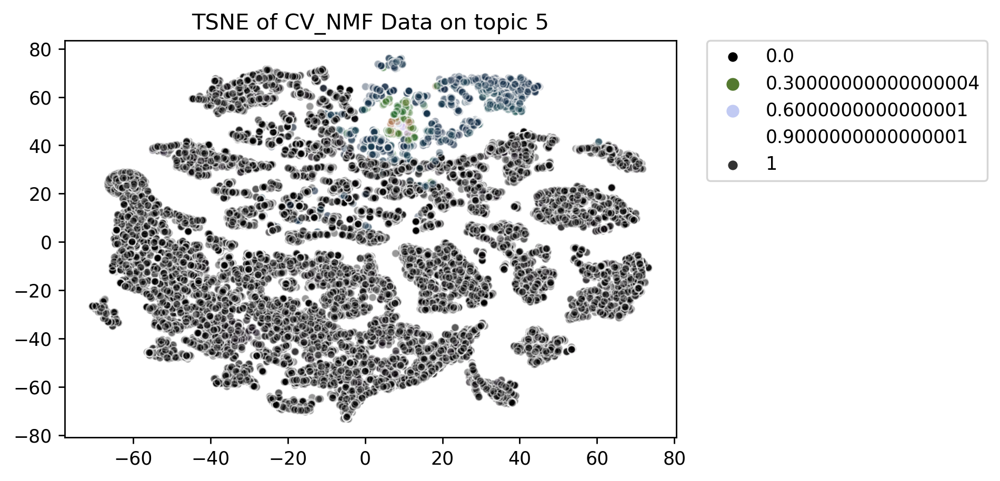

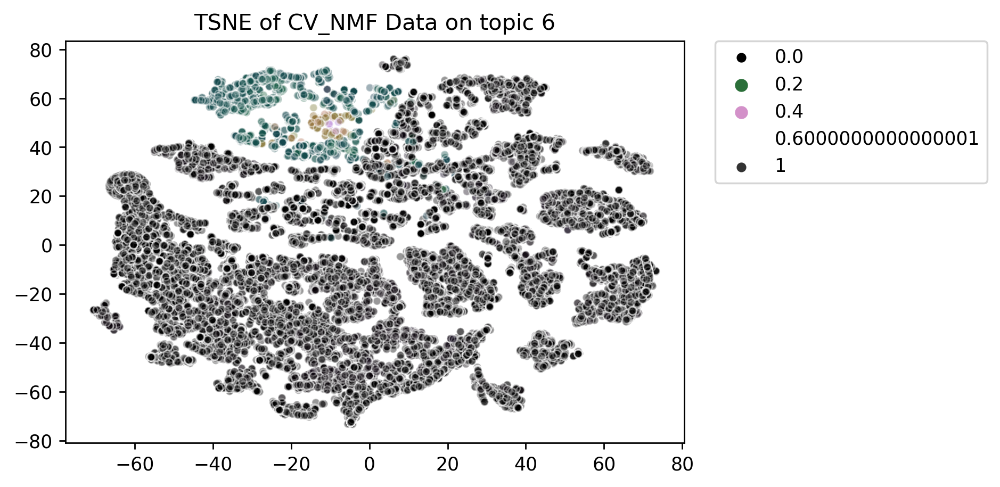

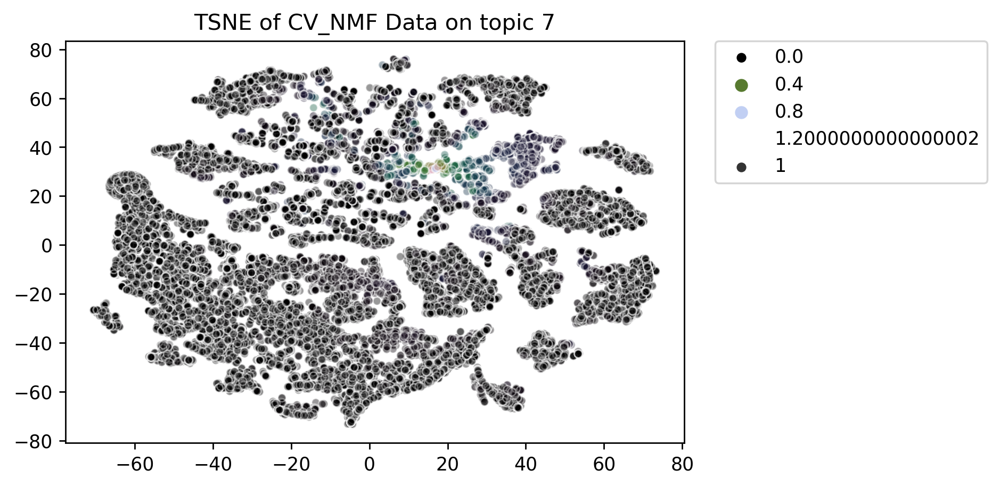

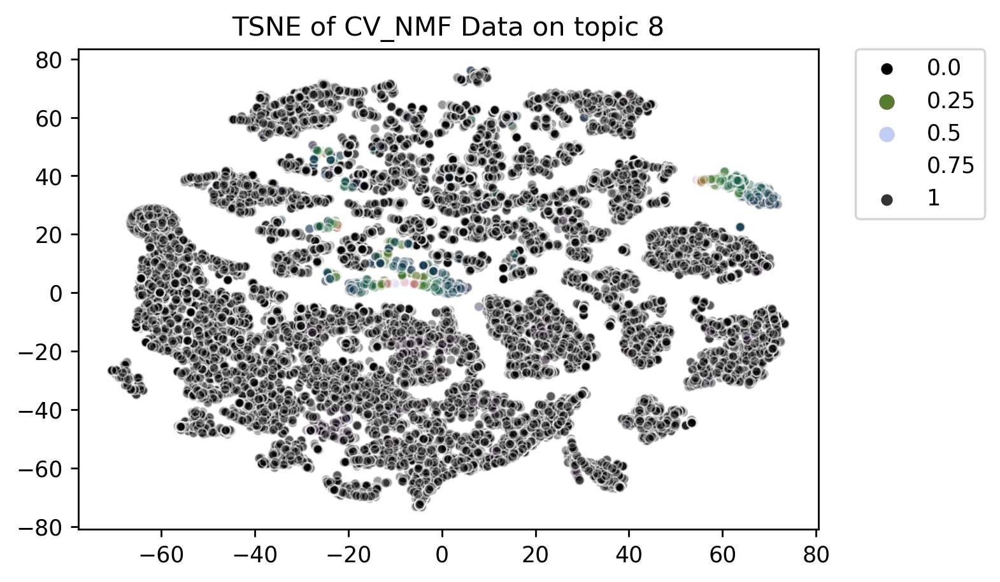

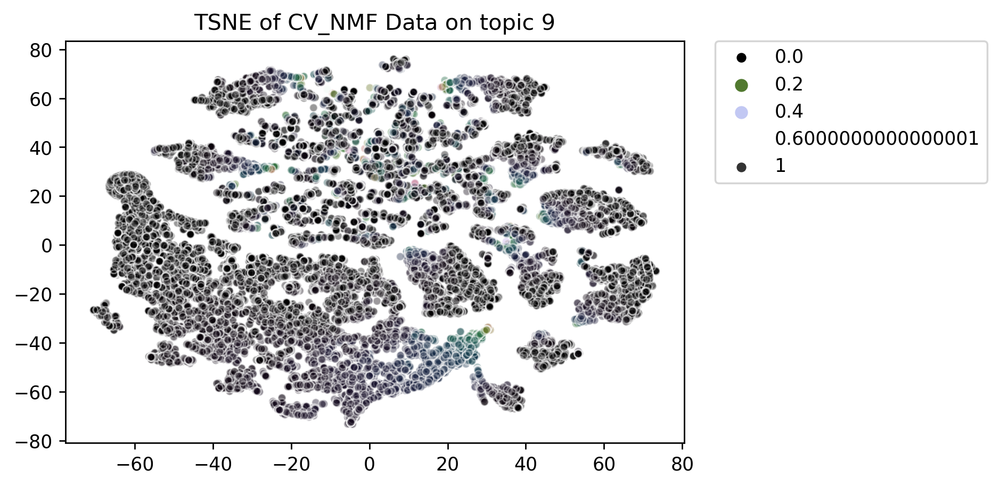

In [89]:
for i in range(10):
    checkfeature_on_tsne(cv_nmf_embedded, 'TSNE of CV_NMF Data', cv_nmf_data, i)

In [64]:
with open('./data/processed/cv_nmf_embedded.pkl', 'wb') as picklefile:
    pickle.dump(cv_nmf_embedded, picklefile)

In [42]:
SSEs = []
X = StandardScaler().fit_transform(lsa_tfidf_data)
for k in range(2,100,4):
    print ('clustering trial:', k)
    km = KMeans(n_clusters=k, random_state=1)
    km.fit(X)
    labels = km.labels_
    #Sil_coefs.append(metrics.silhouette_score(lsa_tfidf_data, labels, metric='euclidean'))
    SSEs.append(get_SSE(X, labels)) # The SSE is just inertia, we could have just said km.inertia_

clustering trial: 2
clustering trial: 6
clustering trial: 10
clustering trial: 14
clustering trial: 18
clustering trial: 22
clustering trial: 26
clustering trial: 30
clustering trial: 34
clustering trial: 38
clustering trial: 42
clustering trial: 46
clustering trial: 50
clustering trial: 54
clustering trial: 58
clustering trial: 62
clustering trial: 66
clustering trial: 70
clustering trial: 74
clustering trial: 78
clustering trial: 82
clustering trial: 86
clustering trial: 90
clustering trial: 94
clustering trial: 98


In [28]:
df_ticket_google.shape

(28787, 300)

In [43]:
google_SSEs = []
google_X = StandardScaler().fit_transform(df_ticket_google)
for k in range(2,100,4):
    print ('clustering trial:', k)
    km = KMeans(n_clusters=k, random_state=1)
    km.fit(google_X)
    labels = km.labels_
    #Sil_coefs.append(metrics.silhouette_score(lsa_tfidf_data, labels, metric='euclidean'))
    google_SSEs.append(get_SSE(google_X, labels)) # The SSE is just inertia, we could have just said km.inertia_

clustering trial: 2
clustering trial: 6
clustering trial: 10
clustering trial: 14
clustering trial: 18
clustering trial: 22
clustering trial: 26
clustering trial: 30
clustering trial: 34
clustering trial: 38
clustering trial: 42
clustering trial: 46
clustering trial: 50
clustering trial: 54
clustering trial: 58
clustering trial: 62
clustering trial: 66
clustering trial: 70
clustering trial: 74
clustering trial: 78
clustering trial: 82
clustering trial: 86
clustering trial: 90
clustering trial: 94
clustering trial: 98


Text(0.5,1,'SSE vs Clusters')

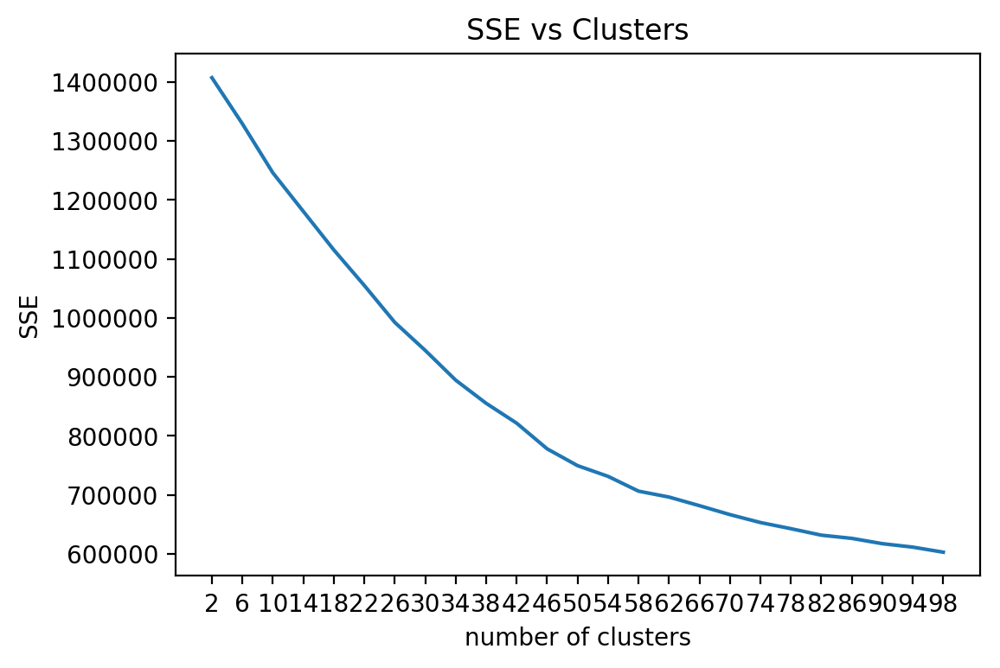

In [44]:
k_clusters = range(2,100,4)
plt.figure(dpi=200)

# plot Intertia/SSE on ax2
plt.plot(k_clusters, SSEs)
plt.xlabel('number of clusters')
plt.ylabel('SSE')
plt.xticks(np.arange(2, 100, step=4));
plt.title ('SSE vs Clusters')

Text(0.5,1,'SSE vs Google Clusters')

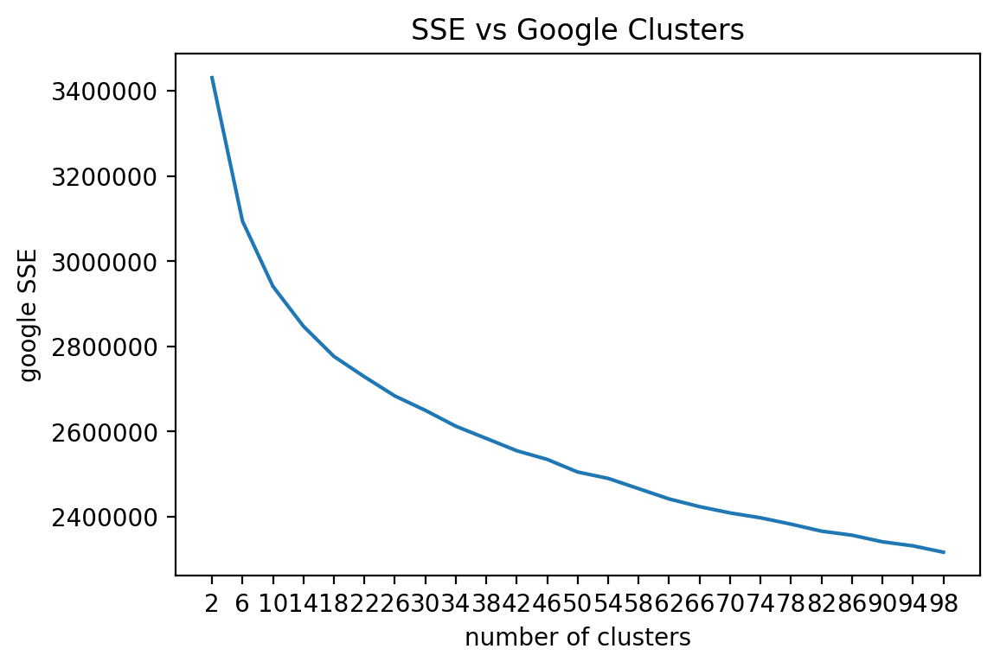

In [47]:
k_clusters = range(2,100,4)
plt.figure(dpi=200)

# plot Intertia/SSE on ax2
plt.plot(k_clusters, google_SSEs)
plt.xlabel('number of clusters')
plt.ylabel('google SSE')
plt.xticks(np.arange(2, 100, step=4));
plt.title ('SSE vs Google Clusters')

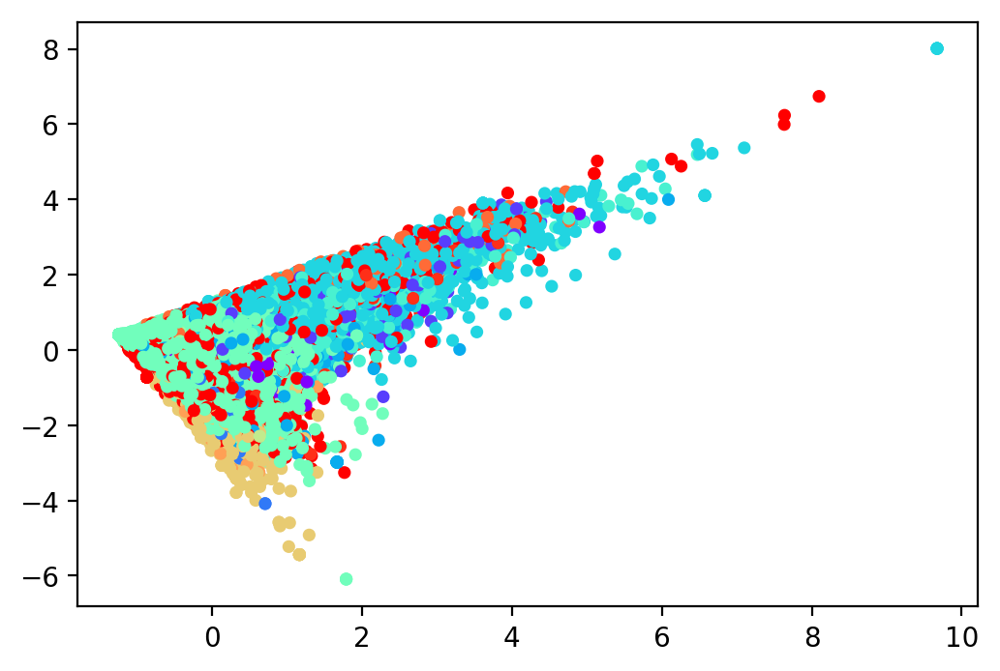

In [39]:
X = StandardScaler().fit_transform(lsa_tfidf_data)
km = KMeans(n_clusters=20)
ypred_lsa = km.fit_predict(X)
plt.figure(dpi=200)
plt.scatter(X[:,0],X[:,1],c=plt.cm.rainbow(ypred_lsa*20),s=14);

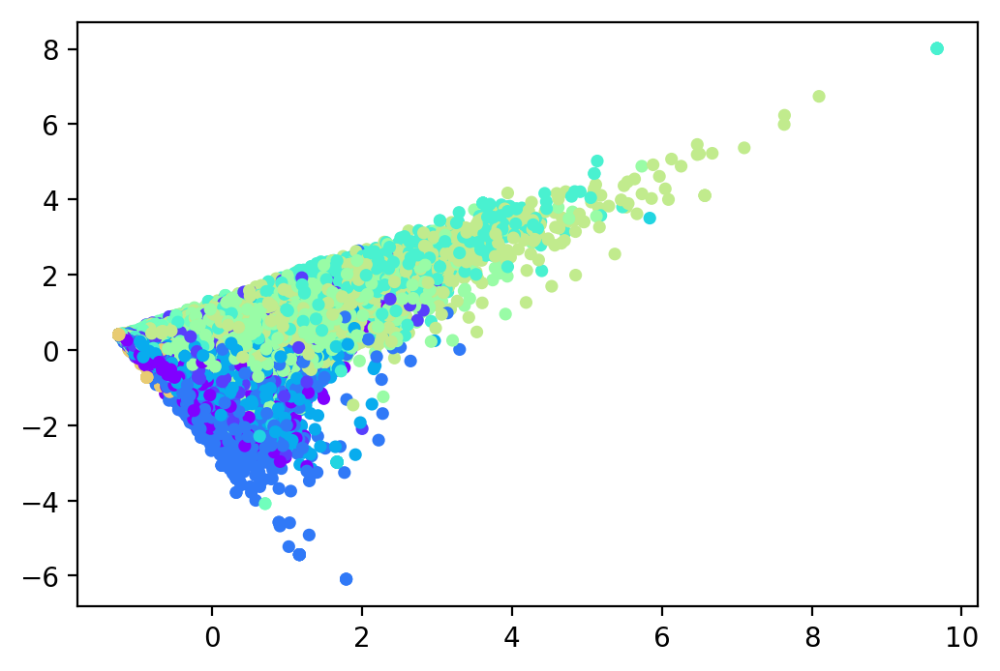

In [34]:
google_X = StandardScaler().fit_transform(df_ticket_google)
km = KMeans(n_clusters=10)
ypred_google = km.fit_predict(google_X)
plt.figure(dpi=200)
plt.scatter(X[:,0],X[:,1],c=plt.cm.rainbow(ypred_google*20),s=14);

In [26]:
from sklearn.manifold import TSNE

X_embedded = TSNE(n_components=2, verbose=1, perplexity=50).fit_transform(lsa_tfidf_data)
X_embedded.shape

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 28787 samples in 0.128s...
[t-SNE] Computed neighbors for 28787 samples in 94.825s...
[t-SNE] Computed conditional probabilities for sample 1000 / 28787
[t-SNE] Computed conditional probabilities for sample 2000 / 28787
[t-SNE] Computed conditional probabilities for sample 3000 / 28787
[t-SNE] Computed conditional probabilities for sample 4000 / 28787
[t-SNE] Computed conditional probabilities for sample 5000 / 28787
[t-SNE] Computed conditional probabilities for sample 6000 / 28787
[t-SNE] Computed conditional probabilities for sample 7000 / 28787
[t-SNE] Computed conditional probabilities for sample 8000 / 28787
[t-SNE] Computed conditional probabilities for sample 9000 / 28787
[t-SNE] Computed conditional probabilities for sample 10000 / 28787
[t-SNE] Computed conditional probabilities for sample 11000 / 28787
[t-SNE] Computed conditional probabilities for sample 12000 / 28787
[t-SNE] Computed conditional probabilities for s

(28787, 2)

In [40]:
with open('./data/processed/X_embedded.pkl', 'wb') as picklefile:
    pickle.dump(X_embedded, picklefile)

In [4]:
with open('./data/processed/X_embedded.pkl', 'rb') as picklefile:
    X_embedded = pickle.load(picklefile)

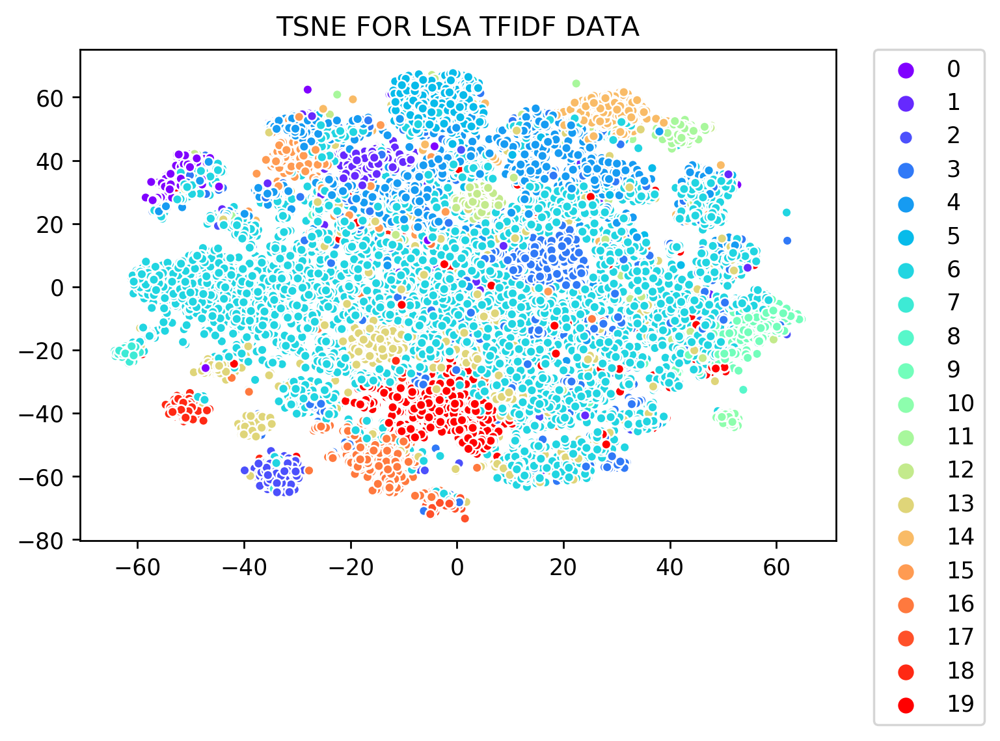

In [41]:
plt.figure(dpi=250)
plt.title("TSNE FOR LSA TFIDF DATA")
sns.scatterplot(X_embedded[:, 0], X_embedded[:, 1], ypred_lsa,
               size = 2, palette = 'rainbow', alpha = 'auto',
              markers = '.', legend="full");

plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);

In [31]:
google_embedded = TSNE(n_components=2, verbose=1, perplexity=50).fit_transform(google_X)
google_embedded.shape

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 28787 samples in 0.547s...
[t-SNE] Computed neighbors for 28787 samples in 524.497s...
[t-SNE] Computed conditional probabilities for sample 1000 / 28787
[t-SNE] Computed conditional probabilities for sample 2000 / 28787
[t-SNE] Computed conditional probabilities for sample 3000 / 28787
[t-SNE] Computed conditional probabilities for sample 4000 / 28787
[t-SNE] Computed conditional probabilities for sample 5000 / 28787
[t-SNE] Computed conditional probabilities for sample 6000 / 28787
[t-SNE] Computed conditional probabilities for sample 7000 / 28787
[t-SNE] Computed conditional probabilities for sample 8000 / 28787
[t-SNE] Computed conditional probabilities for sample 9000 / 28787
[t-SNE] Computed conditional probabilities for sample 10000 / 28787
[t-SNE] Computed conditional probabilities for sample 11000 / 28787
[t-SNE] Computed conditional probabilities for sample 12000 / 28787
[t-SNE] Computed conditional probabilities for 

(28787, 2)

In [42]:
with open('./data/processed/google_embedded.pkl', 'wb') as picklefile:
    pickle.dump(google_embedded, picklefile)

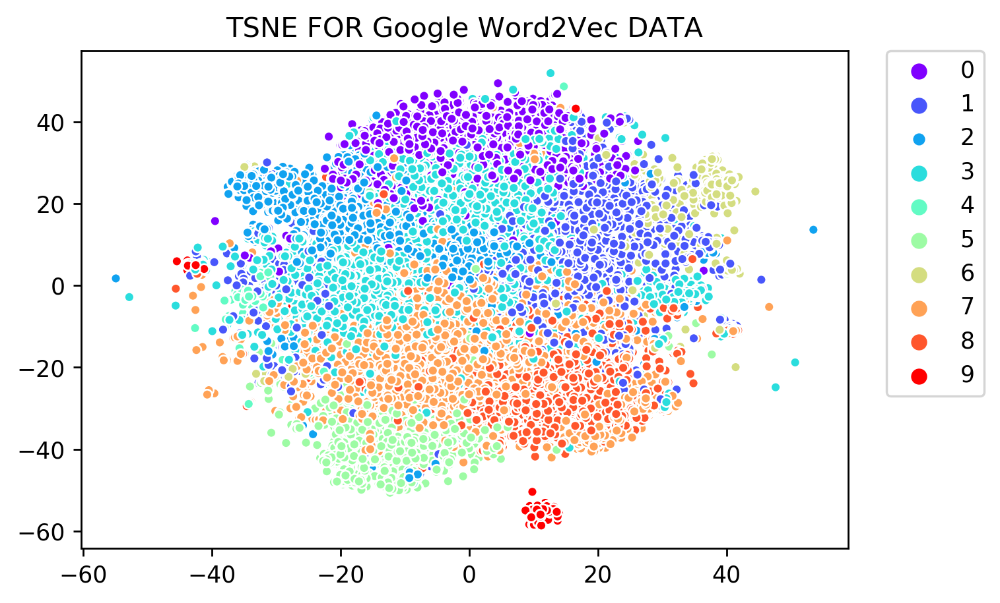

In [36]:
plt.figure(dpi=250)
plt.title("TSNE FOR Google Word2Vec DATA")
sns.scatterplot(google_embedded[:, 0], google_embedded[:, 1], ypred_google,
               size = 2, palette = 'rainbow', alpha = 'auto',
              markers = '.', legend="full");

plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);

### Experiment with different parameters

In [32]:
engine_dict ={
    0:'tfidf_10_lsa',
    1:'tfidf_10_nmf',
    2:'tfidf_20_lsa',
    3:'tfidf_20_nmf',
    4:'tfidf_30_lsa',
    5:'tfidf_30_nmf',
    6:'tfidf_40_lsa',
    7:'tfidf_40_nmf',
    8:'tfidf_50_lsa',
    9:'tfidf_50_nmf',
    10:'cv_10_lsa',
    11:'cv_10_nmf',
    12:'cv_20_lsa',
    13:'cv_20_nmf',
    14:'cv_30_lsa',
    15:'cv_30_nmf',
    16:'cv_40_lsa',
    17:'cv_40_nmf',
    18:'cv_50_lsa',
    19:'cv_50_nmf'
}

In [134]:
vectorizers = [tfidf_vectorizer, count_vectorizer]
n_components = np.arange(50, 310, 50)
reducers = [TruncatedSVD, NMF]
df_subset = df_ticket[0:2000]

In [139]:
veduced_data = []
tsned_data = []
for vectorizer in vectorizers:
    for component in n_components:
        for reducer in reducers:
            engine = RecommendationEngine(vectorizer, component, reducer, ticket = ticket_origin, solution=solution_origin)
            topic_data = engine.fit(df_subset)
            veduced_data.append(topic_data)
            data_embedded = TSNE(n_components=2, verbose=1, perplexity=50).fit_transform(topic_data)
            tsned_data.append(data_embedded)

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 2000 samples in 0.001s...
[t-SNE] Computed neighbors for 2000 samples in 0.177s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2000
[t-SNE] Computed conditional probabilities for sample 2000 / 2000
[t-SNE] Mean sigma: 0.018699
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.043182
[t-SNE] Error after 1000 iterations: 0.890100
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 2000 samples in 0.002s...
[t-SNE] Computed neighbors for 2000 samples in 0.159s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2000
[t-SNE] Computed conditional probabilities for sample 2000 / 2000
[t-SNE] Mean sigma: 0.007566
[t-SNE] KL divergence after 250 iterations with early exaggeration: 63.498165
[t-SNE] Error after 1000 iterations: 0.609628
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 2000 samples in 0.002s...
[t-SNE] Computed neighbors for 2000 samples in 0.337s...
[t-S

[t-SNE] Computed neighbors for 2000 samples in 0.409s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2000
[t-SNE] Computed conditional probabilities for sample 2000 / 2000
[t-SNE] Mean sigma: 0.010346
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.283981
[t-SNE] Error after 1000 iterations: 0.879354


/Users/songlin/anaconda2/envs/Python36/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


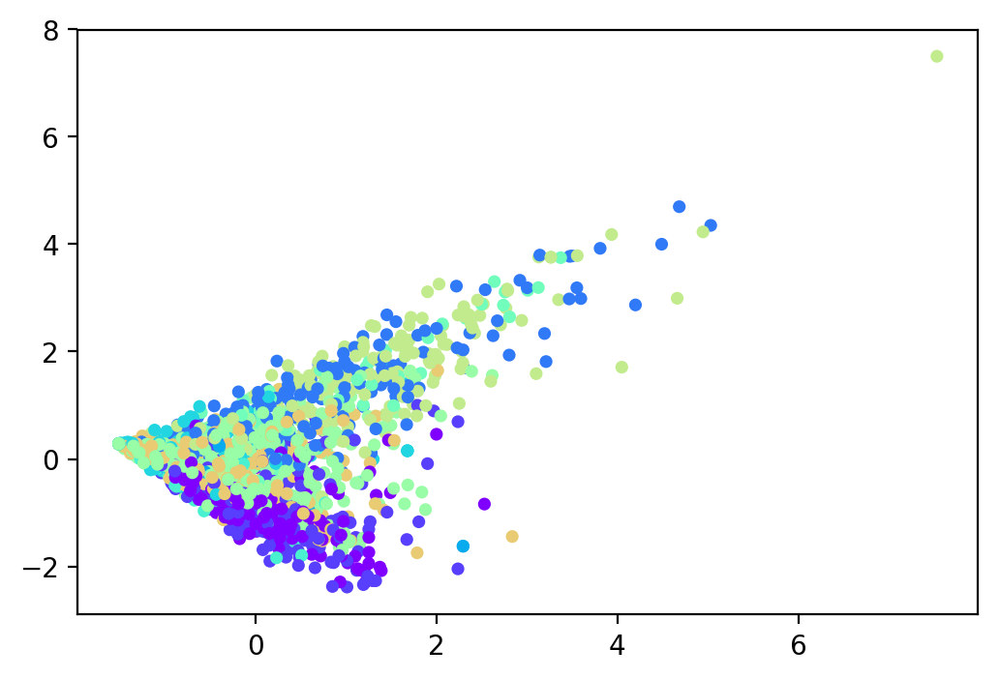

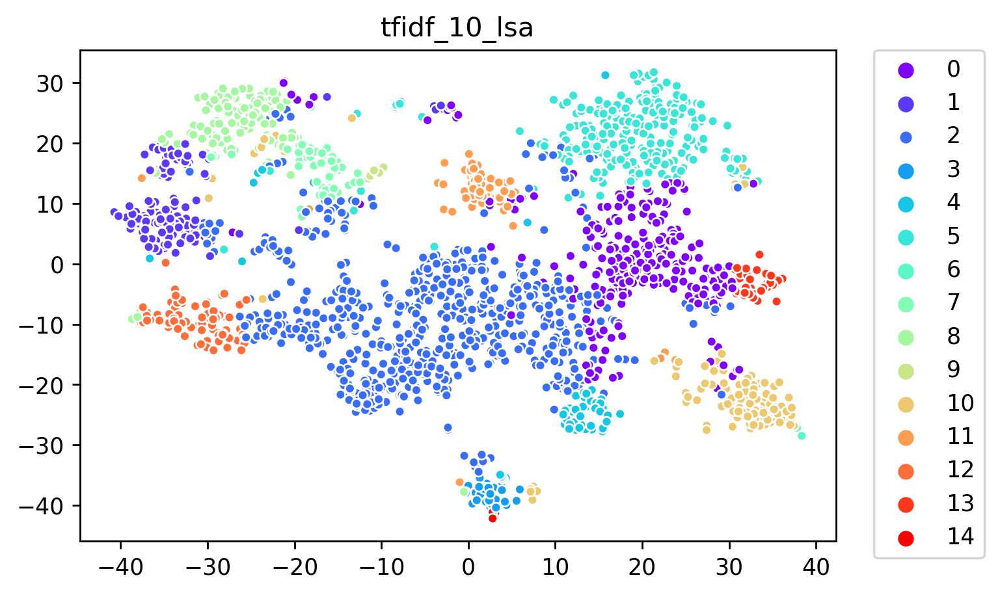

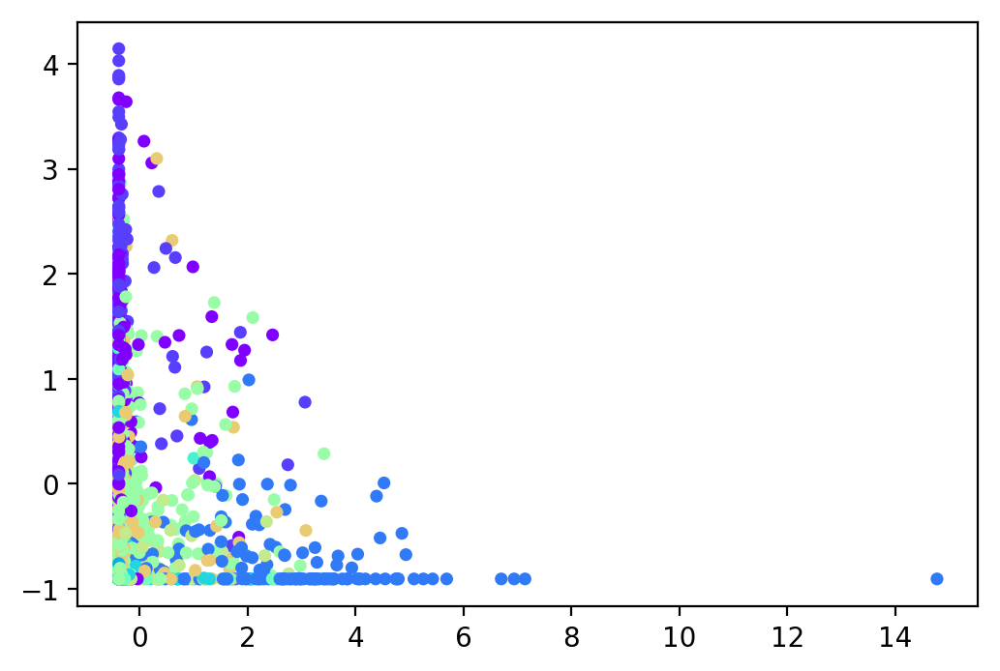

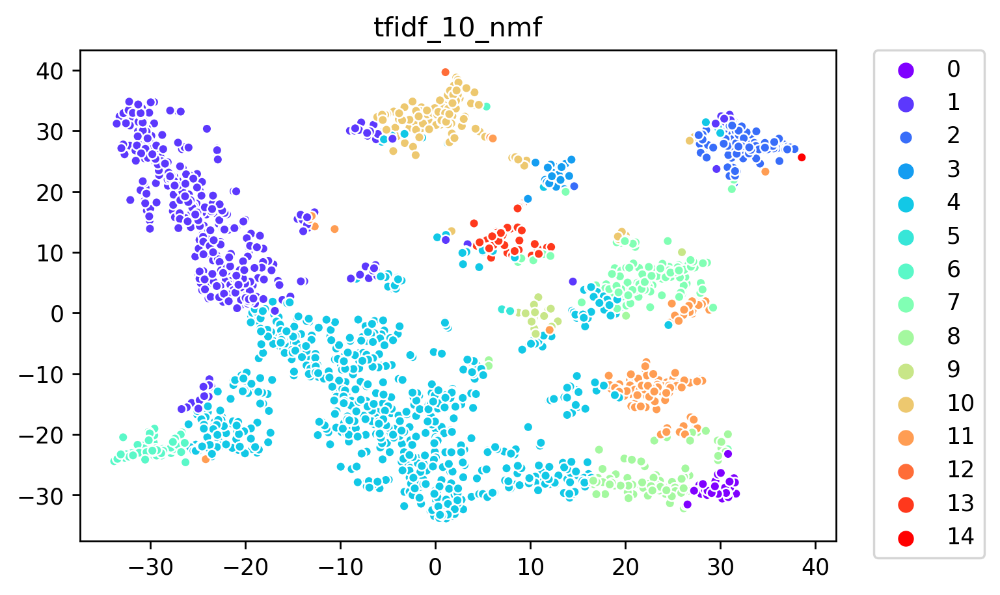

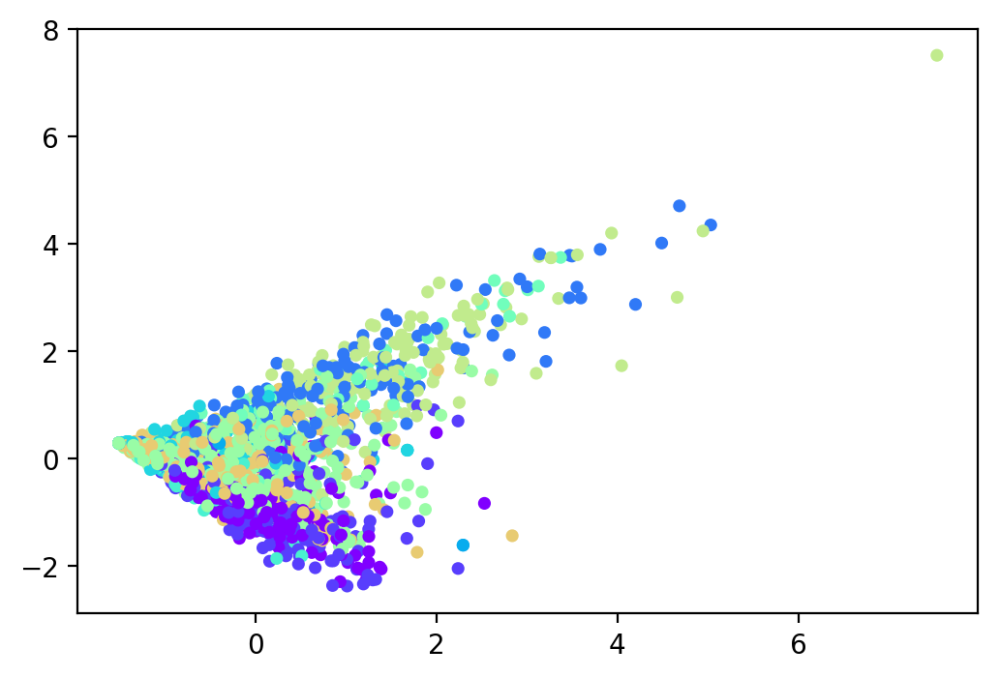

...

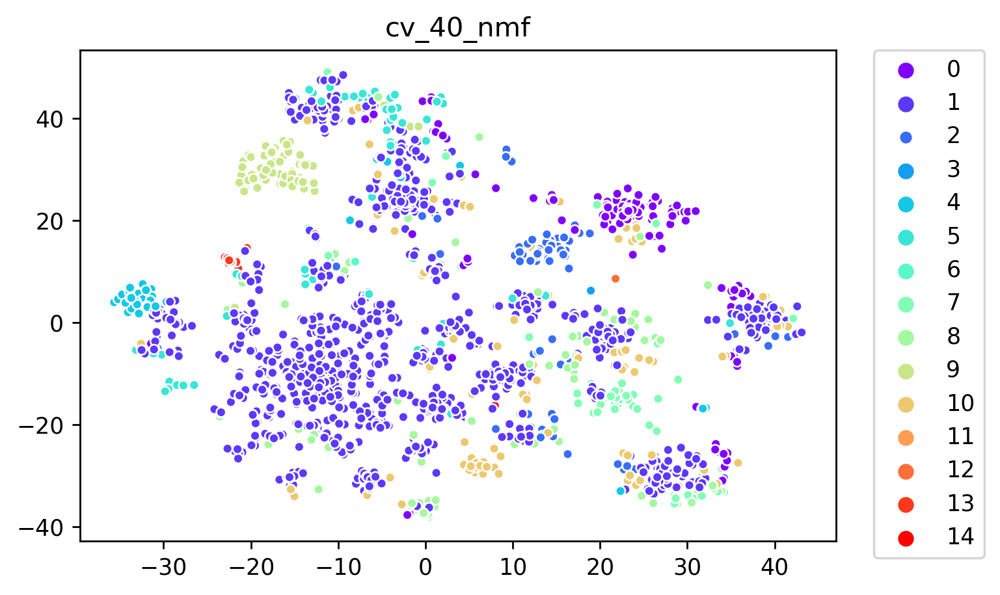

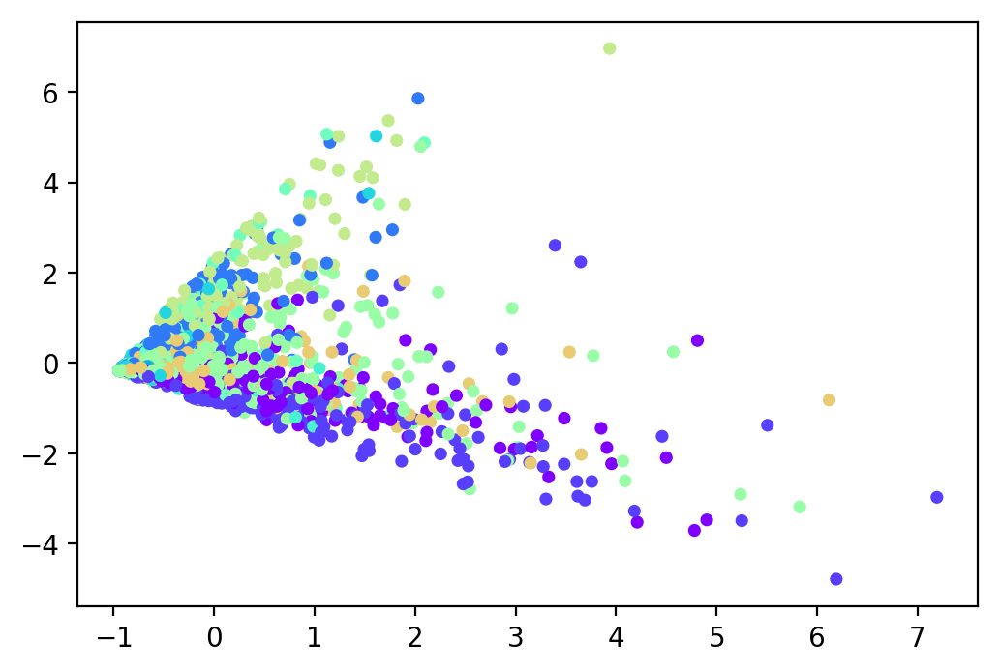

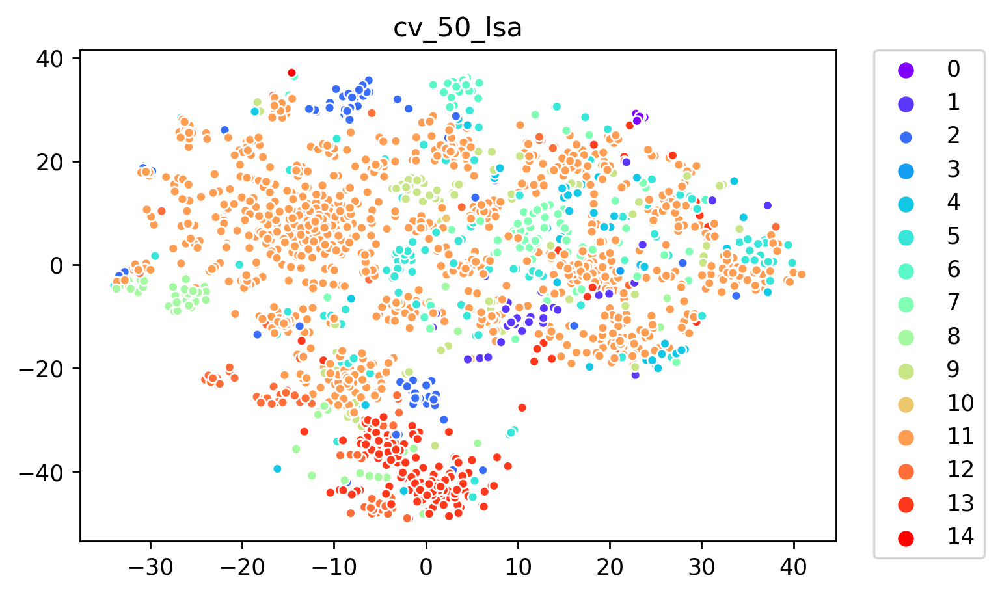

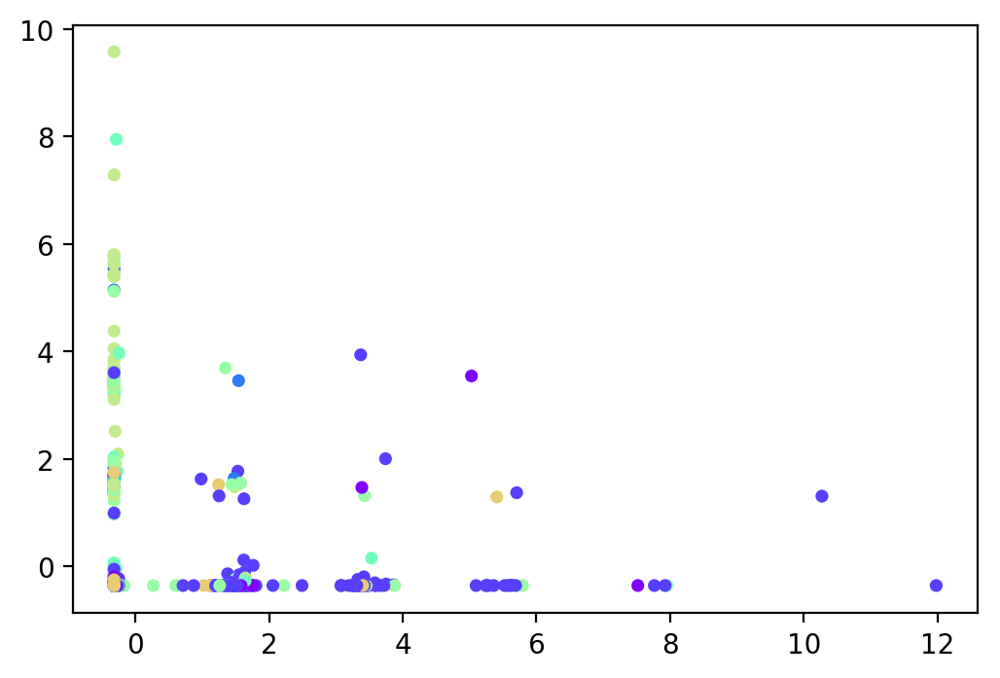

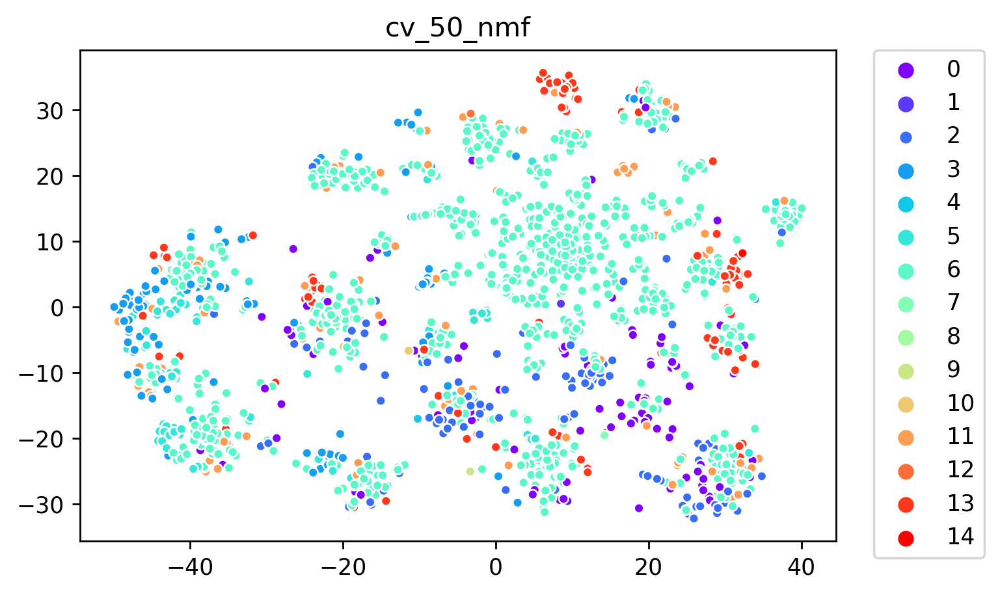

In [156]:
y_preds = []
for i in range(len(veduced_data)):
    y_pred = fitKmeans(veduced_data[i], 15)
    y_preds.append(y_pred)
    plot_on_tsne(y_pred, engine_dict[i], tsned_data[i])

In [145]:
with open('./data/processed/tsned_data.pkl', 'wb') as picklefile:
    pickle.dump(tsned_data, picklefile)
with open('./data/processed/veduced_data.pkl', 'wb') as picklefile:
    pickle.dump(veduced_data, picklefile)

In [31]:
with open('./data/processed/tsned_data.pkl', 'rb') as picklefile:
    tsned_data = pickle.load(picklefile)
with open('./data/processed/veduced_data.pkl', 'rb') as picklefile:
    veduced_data = pickle.load(picklefile)

### Try Higher dimension topics

In [161]:
engine_dict2 = {
0:'tfidf_50_lsa',
1:'tfidf_50_nmf',
2:'tfidf_100_lsa',
3:'tfidf_100_nmf',
4:'tfidf_150_lsa',
5:'tfidf_150_nmf',
6:'tfidf_200_lsa',
7:'tfidf_200_nmf',
8:'tfidf_250_lsa',
9:'tfidf_250_nmf',
10:'tfidf_300_lsa',
11:'tfidf_300_nmf',
12:'cv_50_lsa',
13:'cv_50_nmf',
14:'cv_100_lsa',
15:'cv_100_nmf',
16:'cv_150_lsa',
17:'cv_150_nmf',
18:'cv_200_lsa',
19:'cv_200_nmf',
20:'cv_250_lsa',
21:'cv_250_nmf',
22:'cv_300_lsa',
23:'cv_300_nmf'
}

In [159]:
vectorizers = [tfidf_vectorizer, count_vectorizer]
n_components = np.arange(50, 310, 50)
reducers = [TruncatedSVD, NMF]

In [160]:
veduced_data2 = []
tsned_data2 = []
for vectorizer in vectorizers:
    for component in n_components:
        for reducer in reducers:
            engine = RecommendationEngine(vectorizer, component, reducer, ticket = ticket_origin, solution=solution_origin)
            topic_data = engine.fit(df_subset)
            veduced_data2.append(topic_data)
            data_embedded = TSNE(n_components=2, verbose=1, perplexity=50).fit_transform(topic_data)
            tsned_data2.append(data_embedded)

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 2000 samples in 0.003s...
[t-SNE] Computed neighbors for 2000 samples in 0.497s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2000
[t-SNE] Computed conditional probabilities for sample 2000 / 2000
[t-SNE] Mean sigma: 0.060819
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.857277
[t-SNE] Error after 1000 iterations: 1.568232
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 2000 samples in 0.005s...
[t-SNE] Computed neighbors for 2000 samples in 0.439s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2000
[t-SNE] Computed conditional probabilities for sample 2000 / 2000
[t-SNE] Mean sigma: 0.017764
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.435371
[t-SNE] Error after 1000 iterations: 1.099182
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 2000 samples in 0.004s...
[t-SNE] Computed neighbors for 2000 samples in 0.869s...
[t-S

[t-SNE] Computed neighbors for 2000 samples in 1.682s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2000
[t-SNE] Computed conditional probabilities for sample 2000 / 2000
[t-SNE] Mean sigma: 0.021561
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.324554
[t-SNE] Error after 1000 iterations: 1.015388
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 2000 samples in 0.011s...
[t-SNE] Computed neighbors for 2000 samples in 2.100s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2000
[t-SNE] Computed conditional probabilities for sample 2000 / 2000
[t-SNE] Mean sigma: 0.381417
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.144173
[t-SNE] Error after 1000 iterations: 1.819730
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 2000 samples in 0.015s...
[t-SNE] Computed neighbors for 2000 samples in 1.885s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2000
[t-SNE] Computed condit

/Users/songlin/anaconda2/envs/Python36/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


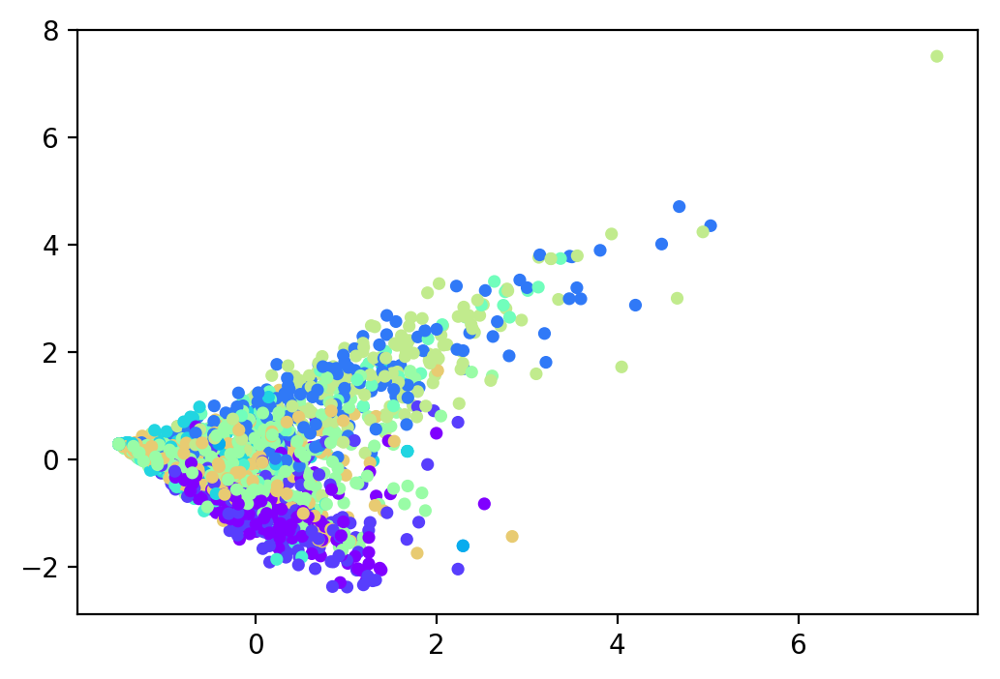

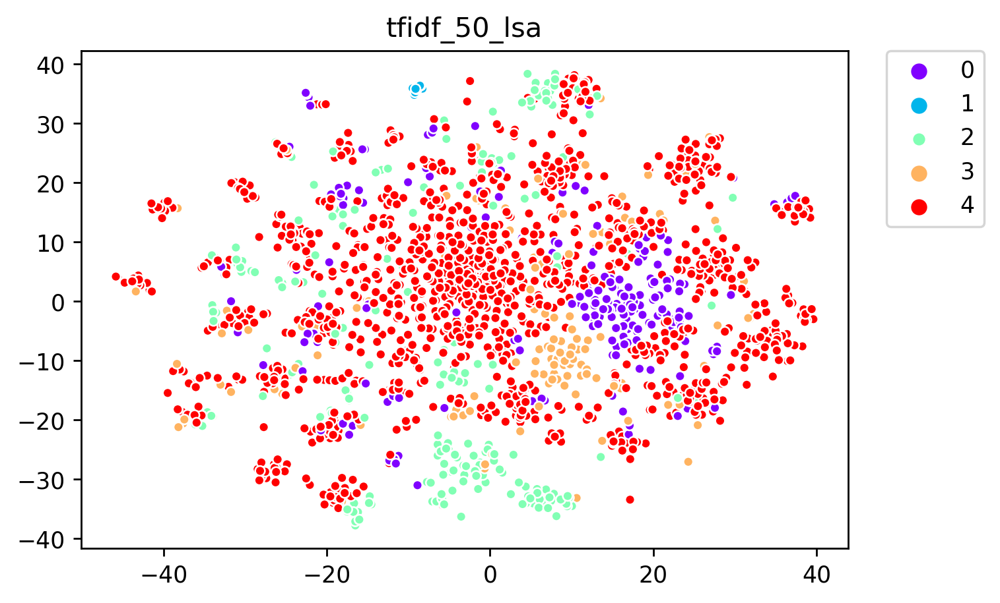

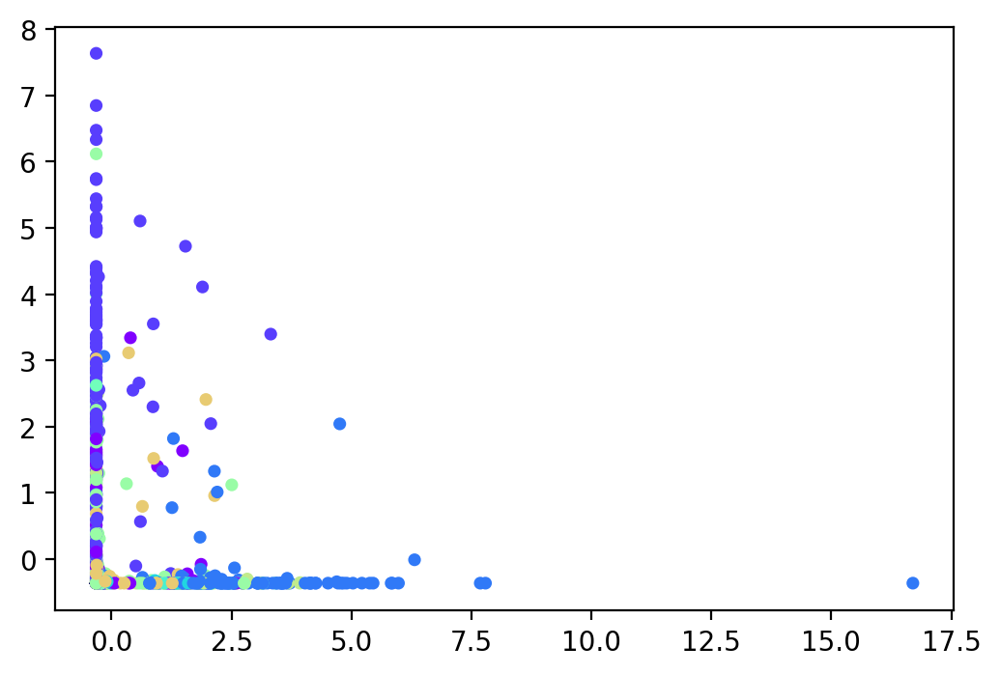

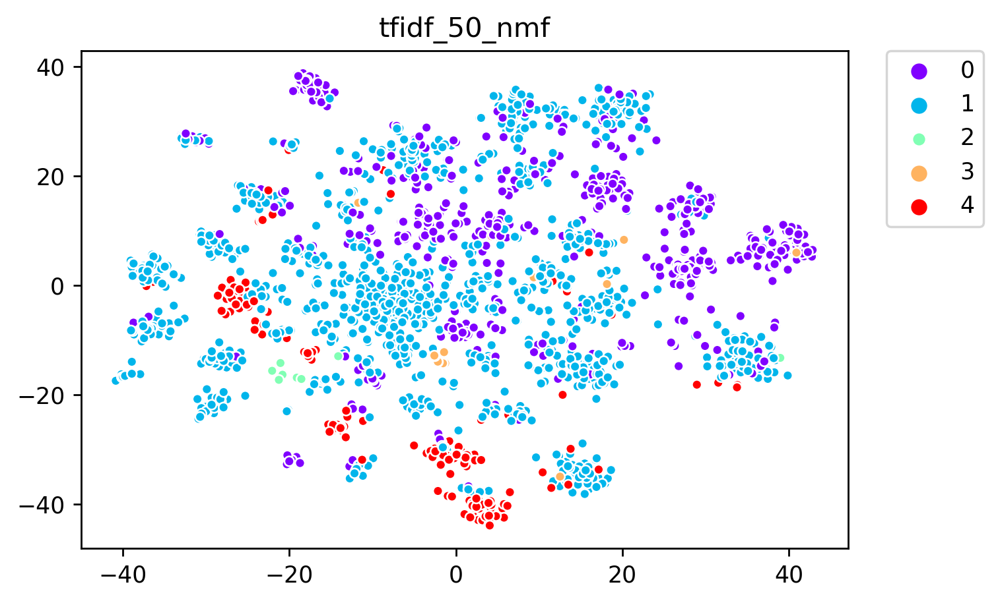

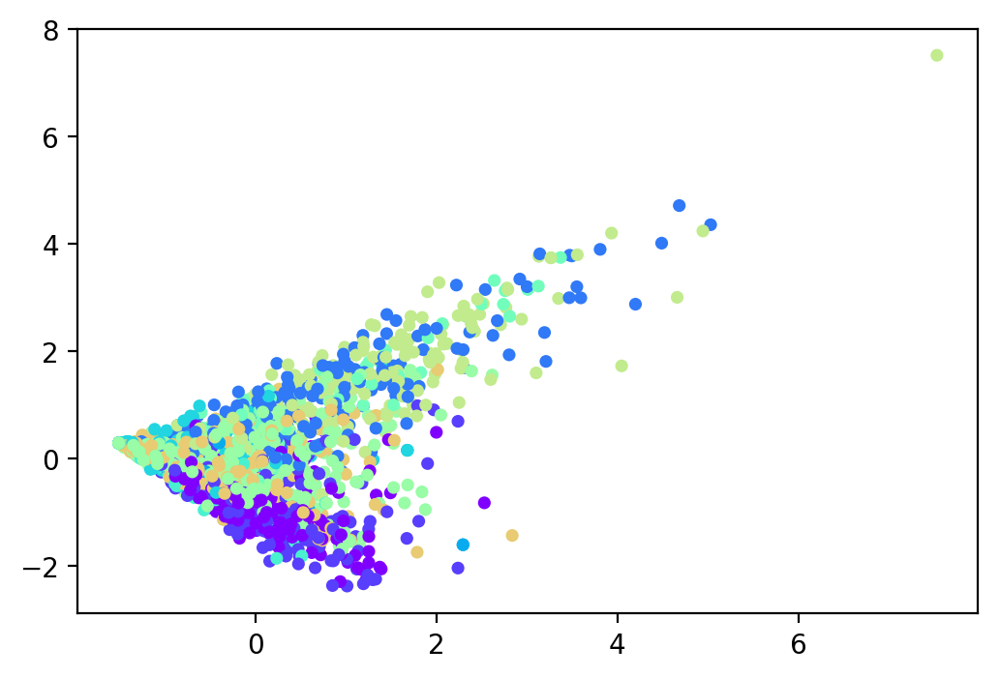

...

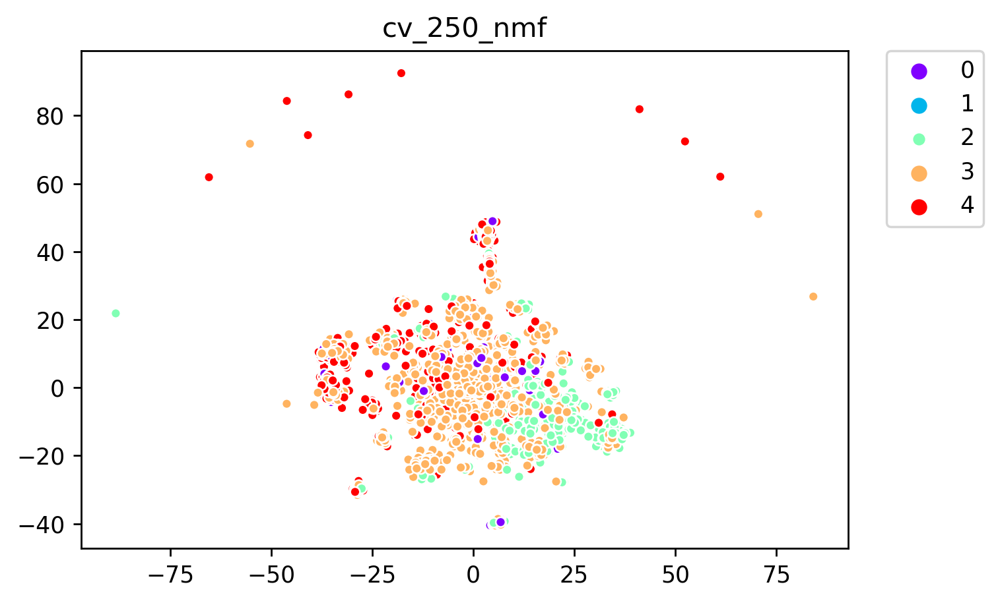

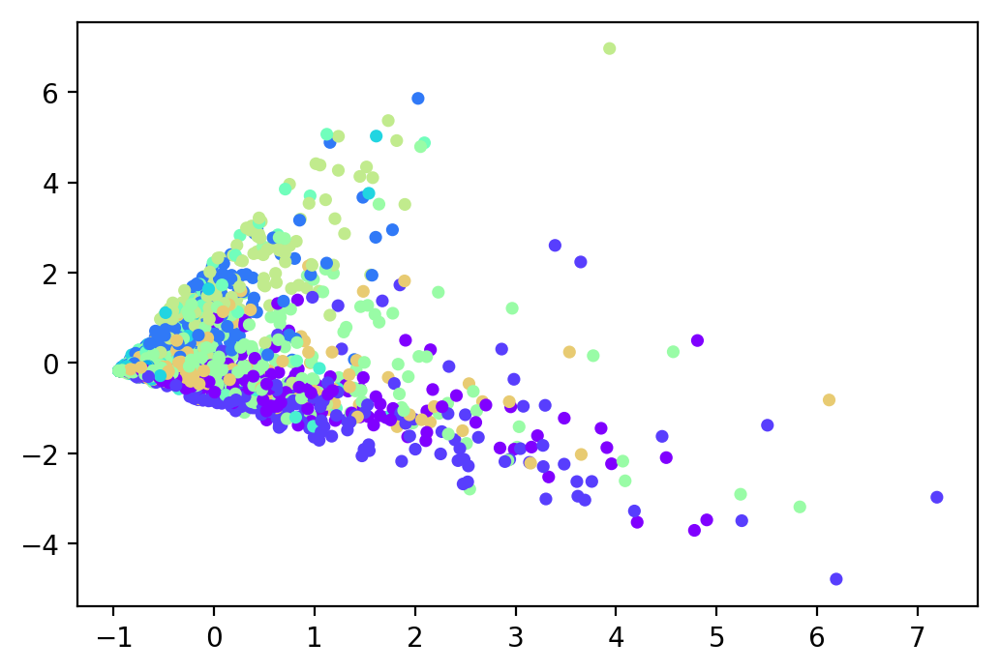

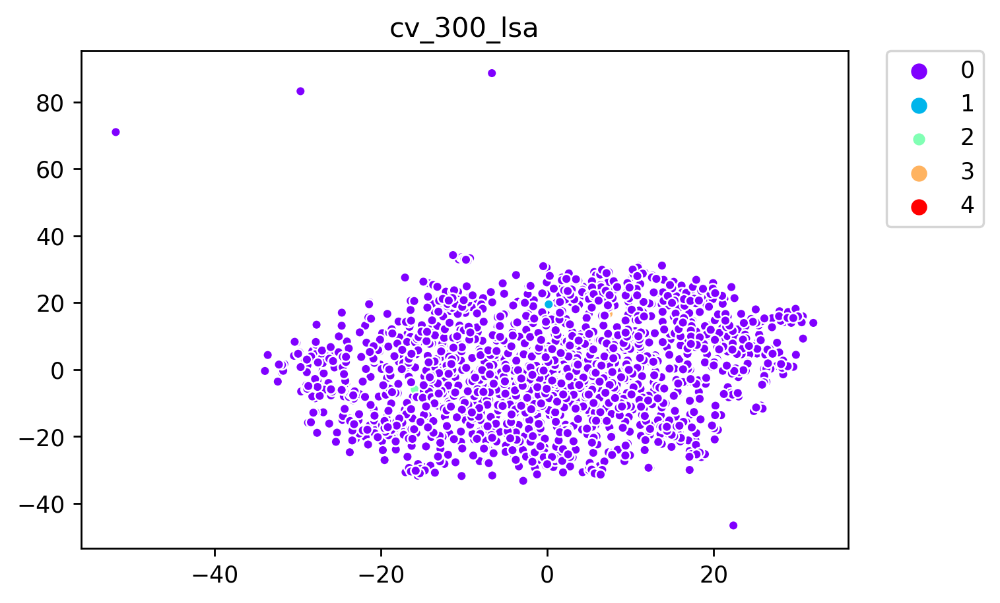

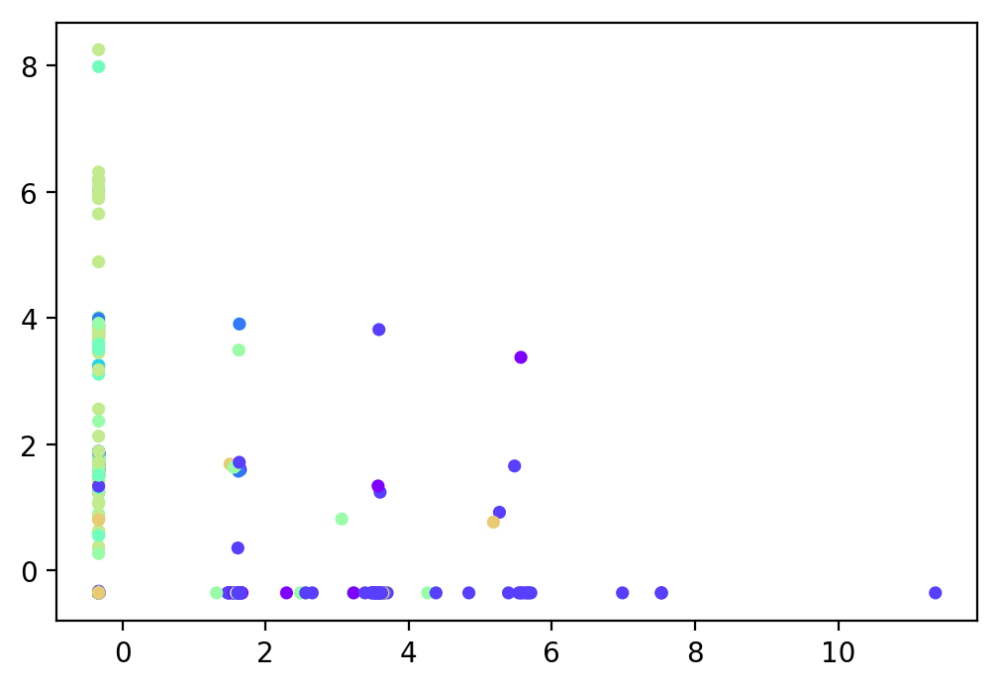

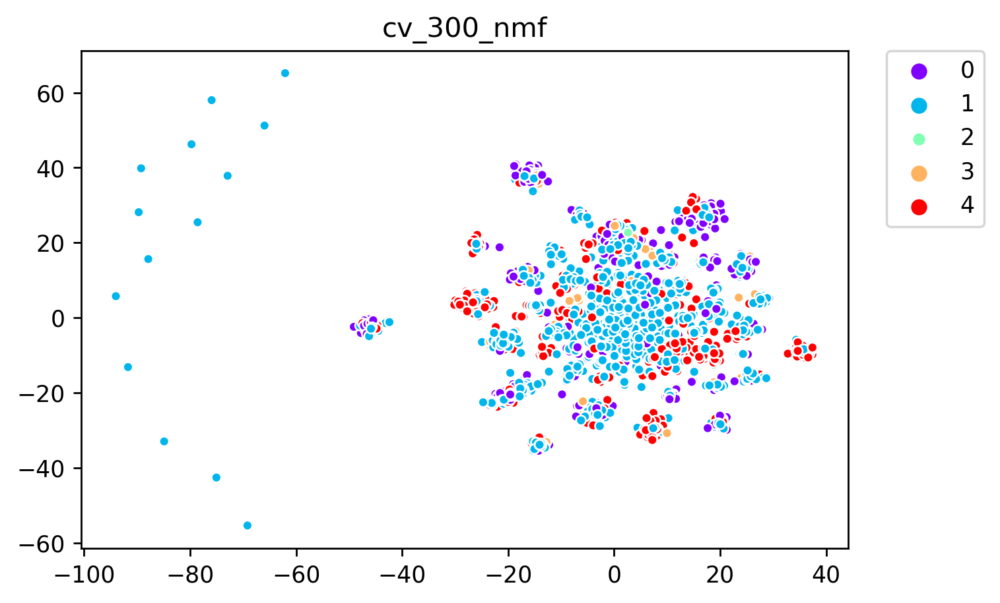

In [165]:
y_preds2 = []
for i in range(len(veduced_data2)):
    y_pred = fitKmeans(veduced_data2[i], 5)
    y_preds2.append(y_pred)
    plot_on_tsne(y_pred, engine_dict2[i], tsned_data2[i])

In [163]:
with open('./data/processed/tsned_data2.pkl', 'wb') as picklefile:
    pickle.dump(tsned_data, picklefile)
with open('./data/processed/veduced_data2.pkl', 'wb') as picklefile:
    pickle.dump(veduced_data, picklefile)

### Fit all the data with better pipelines

In [169]:
good_pipe = ([
    [tfidf_vectorizer, 10, TruncatedSVD],
    [tfidf_vectorizer, 20, TruncatedSVD]
])

In [170]:
veduced_data3 = []
tsned_data3 = []
for model in good_pipe:
    engine = RecommendationEngine(model[0], model[1], model[2], ticket = ticket_origin, solution=solution_origin)
    topic_data = engine.fit(df_ticket)
    veduced_data3.append(topic_data)
    data_embedded = TSNE(n_components=2, verbose=1, perplexity=50).fit_transform(topic_data)
    tsned_data3.append(data_embedded)

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 28787 samples in 0.049s...
[t-SNE] Computed neighbors for 28787 samples in 5.354s...
[t-SNE] Computed conditional probabilities for sample 1000 / 28787
[t-SNE] Computed conditional probabilities for sample 2000 / 28787
[t-SNE] Computed conditional probabilities for sample 3000 / 28787
[t-SNE] Computed conditional probabilities for sample 4000 / 28787
[t-SNE] Computed conditional probabilities for sample 5000 / 28787
[t-SNE] Computed conditional probabilities for sample 6000 / 28787
[t-SNE] Computed conditional probabilities for sample 7000 / 28787
[t-SNE] Computed conditional probabilities for sample 8000 / 28787
[t-SNE] Computed conditional probabilities for sample 9000 / 28787
[t-SNE] Computed conditional probabilities for sample 10000 / 28787
[t-SNE] Computed conditional probabilities for sample 11000 / 28787
[t-SNE] Computed conditional probabilities for sample 12000 / 28787
[t-SNE] Computed conditional probabilities for sa

In [171]:
with open('./data/processed/tsned_data3.pkl', 'wb') as picklefile:
    pickle.dump(tsned_data3, picklefile)
with open('./data/processed/veduced_data3.pkl', 'wb') as picklefile:
    pickle.dump(veduced_data3, picklefile)

In [21]:
with open('./data/processed/tsned_data3.pkl', 'rb') as picklefile:
    tsned_data3 = pickle.load(picklefile)
with open('./data/processed/veduced_data3.pkl', 'rb') as picklefile:
    veduced_data3 = pickle.load(picklefile)

In [44]:
y_pred[0:15]

array([10,  1,  8,  8, 12,  5,  1,  8,  1,  1,  1,  1,  1,  0, 10],
      dtype=int32)

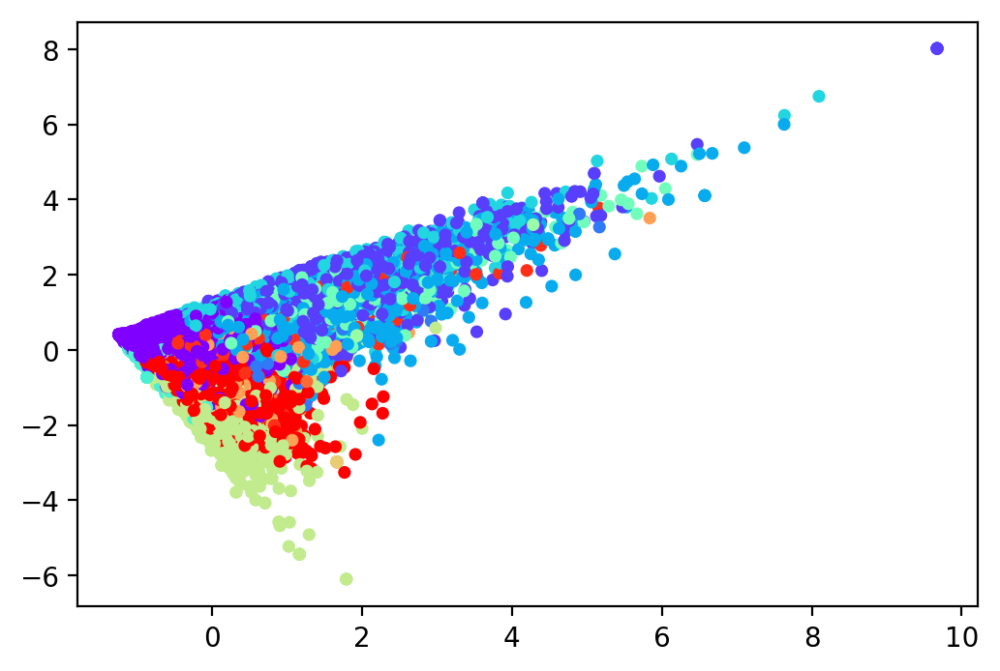

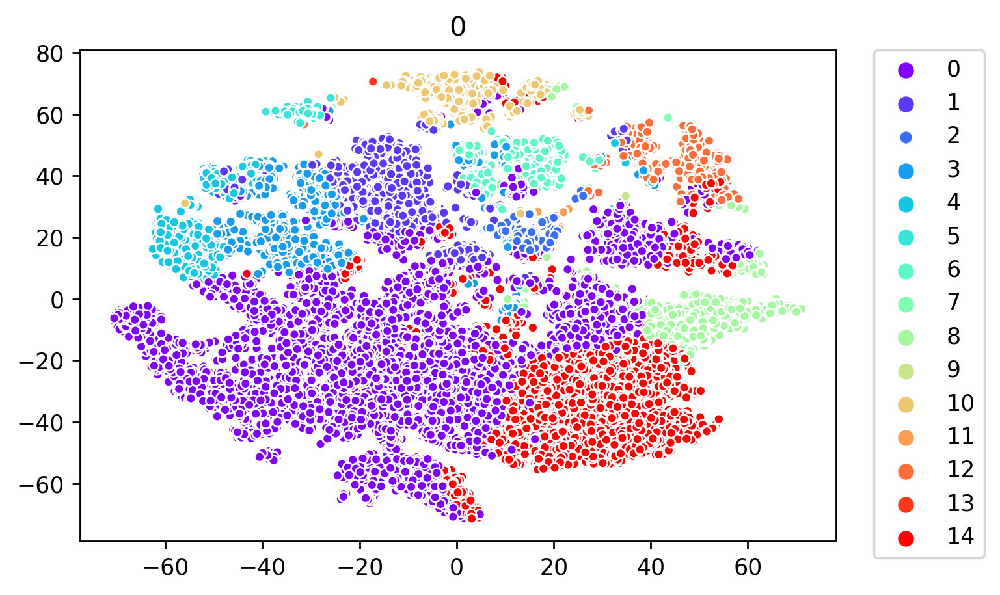

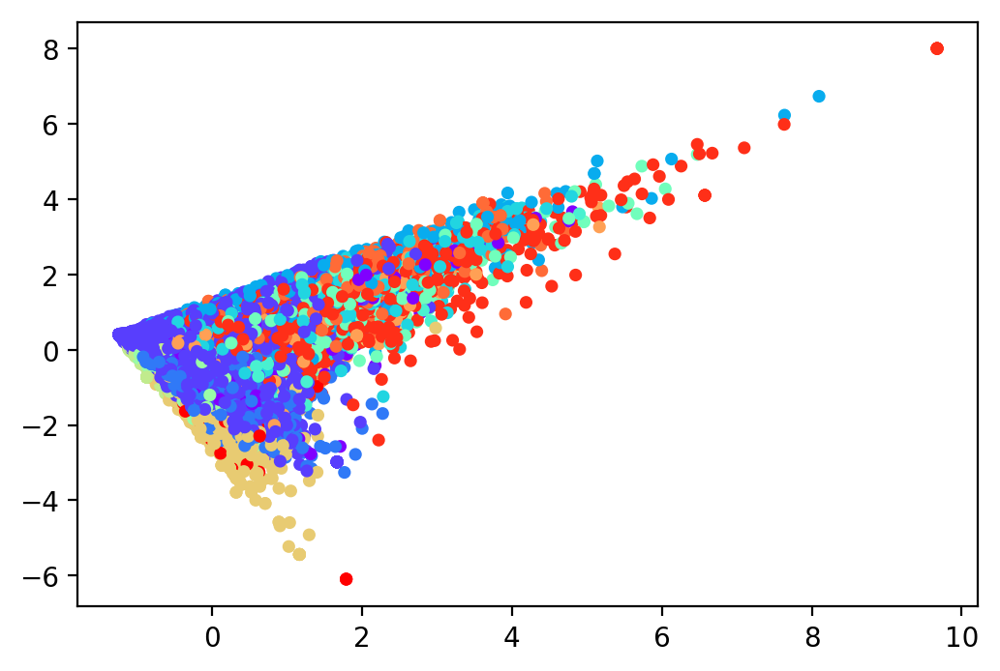

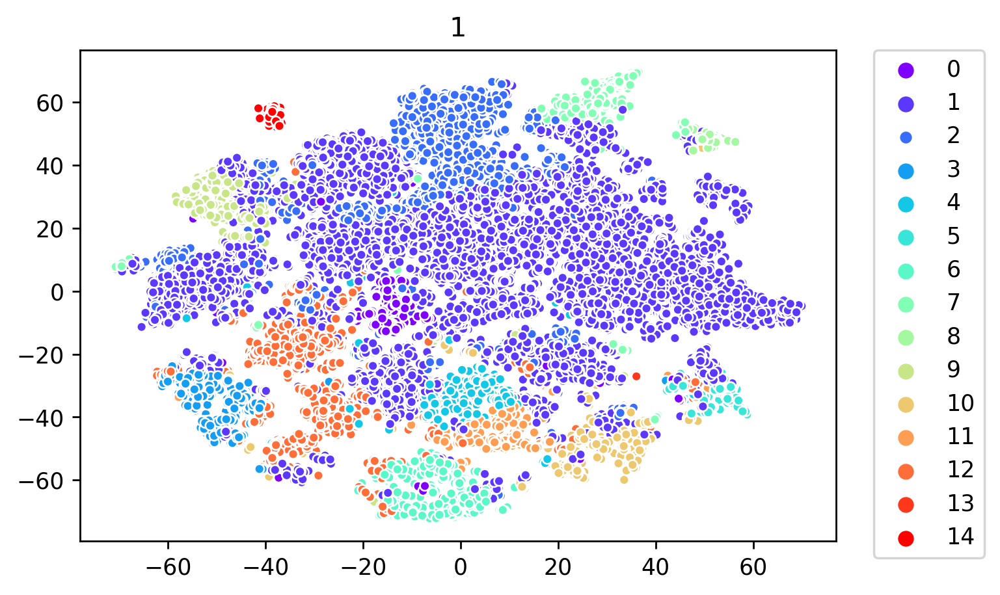

In [53]:
y_preds3 = []
km3 = []
for i in range(len(veduced_data3)):
    y_pred, km = fitKmeans(veduced_data3[i],15)
    y_preds3.append(y_pred)
    km3.append(km)
    plot_on_tsne(y_pred, i, tsned_data3[i])

In [140]:
from copy import deepcopy
def cluster_center10(ticket, cluster, km_model, label, veduced_data):
    ticket = deepcopy(df_ticket)
    ticket['label'] = label
    centers = km_model.cluster_centers_
    cluster_index = ticket[ticket['label'] == cluster].index
    vduced_cluster = veduced_data[cluster_index]
    distances = []
    for point in vduced_cluster:
        dist=np.linalg.norm(point - centers[cluster])
        distances.append(dist)
    cluster_dist = pd.DataFrame(distances, index=cluster_index, columns=['dist'])
    cluster_top10 = ticket.text[cluster_dist.sort_values('dist').head(10).index]
    return cluster_top10

In [136]:
test = veduced_data3[0]
test.shape

(28787, 10)

In [137]:
cluster_index = df_ticket[df_ticket['label'] == 0].index
vduced_cluster = test[cluster_index]

KeyError: 'label'

In [129]:
df_ticket.head()

,case_id,text,sentiment
0,1.0,uh limit songs `` save '' — supposed track alb...,POS
1,2.0,used useful feature ios app allowed user hear ...,POS
2,3.0,’ m pissed shuffle repeat button just don ’ t ...,NEU
3,4.0,groove music quits amp redirect w10m app bugfe...,NEG
4,5.0,way non-explicit songs explicit ok thx,POS


In [157]:
cluster_center10(df_ticket, 14, km3[0], y_preds3[0], veduced_data3[0])


6197     dear make playlist just 5 songs want hear song...
2648                              strangerthings2 playlist
16455                                             playlist
22564    did make playlist yesterday songs just changed...
9219     love make playlist click shuffle play does pla...
27102                       great does play songs playlist
4232                           hey 100 songs 2017 playlist
17155    stop playing '' suggested songs '' songs playl...
12882    don ’ t know guys aware widespread problem pas...
26890          shuffle playlist 800 songs hear 20-30 songs
Name: text, dtype: object

In [198]:
df_ticket.shape

(28787, 3)

In [163]:
index = df_ticket.iloc[6197]['case_id']
ticket_origin[ticket_origin['case_id'] == index]

,tweet_id,created_at,inbound,text,case_id
7984,658161.0,Wed Nov 22 23:00:34 +0000 2017,True,Dear @115888 when I make a playlist (even one ...,6292.0


In [115]:
y_preds3[0].shape

(28787,)

In [97]:
distances = []
for point in vduced_cluster:
    dist=np.linalg.norm(point - centers[cluster])
    distances.append(dist)

In [100]:
cluster_dist = pd.DataFrame(distances, index=cluster_index, columns=['dist'])

In [120]:
cluster_top10 = df_centers.text[cluster_dist.sort_values('dist').head(10).index]

In [121]:
cluster_top10

7561                                dm million dollar idea
18187                                question kindly dm po
21983                         haaaaaaaalp sure dm messaged
8610                                      hiiii look dm xx
26090                                   dm bout issues yea
16859                                                check
8837                                   urgent dm read soon
19981    bug algorithm creates daily mixes where/how re...
6659                           send dm totally forgot link
4919                        dm 'd hours ago replied chance
Name: text, dtype: object

In [ ]:
def find_cluster_closest_verses(verse_cluster, cluster_centers, cluster):
    cluster_center = cluster_centers[cluster][1]
    distances=[]
    for index, cluster, vector in verse_cluster:
        dist=np.linalg.norm(vector-cluster_center)
        distances.append((index,dist))
    distances = sorted(distances, key=lambda x: x[1])
    verses = []
    artist = []
    for i in distances[:10]:
        verses.append(df.verse.iloc[i[0]])
    for i in distances[:10]:
        artist.append(df.artist.iloc[i[0]])
    first_10_distances = distances[:10]
    
    results = list(zip(artist, verses))
    
    return first_10_distances, results